In [32]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
import time

# **Available activation functions**

In [33]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def sigmoid_derivative(x):
    return x * (1 - x)

def linear(x):
    return x

def linear_derivative(x):
    return np.ones_like(x)

def relu(x):
    return np.maximum(0, x)

def relu_derivative(x):
    return np.where(x > 0, 1, 0)

def tanh(x):
    return np.tanh(x)

def tanh_derivative(x):
    return 1 - x**2

def softmax(x):
    return np.exp(x) / np.sum(np.exp(x), axis=1, keepdims=True)

# **Single layer definition**

In [34]:
class Layer:
    
    def __init__(self, input_dim, output_dim, activation='sigmoid', weights_init='uniform'):
        """
        Initializes a single layer in the neural network.

        Parameters:
        - input_dim (int): Number of input neurons (features).
        - output_dim (int): Number of output neurons.
        - activation (str, optional): Activation function to use ('sigmoid' by default). 
          Supported: 'sigmoid', 'linear', 'relu', 'tanh', 'softmax'.
        - weights_init (str, optional): Weight initialization method ('uniform' by default).
          Available methods:
            - 'uniform' : Weights initialized from a uniform distribution.
            - 'normal'  : Weights initialized from a normal distribution.
            - 'xavier'  : Xavier/Glorot initialization (good for tanh).
            - 'he'      : He initialization (good for ReLU).

        Raises:
        - ValueError: If an unknown weight initialization method or activation function is provided.
        """
        
        weight_initializers = {
            'uniform': lambda: np.random.uniform(0, 1, size=(input_dim, output_dim)),
            'normal': lambda: np.random.randn(input_dim, output_dim),  
            'xavier': lambda: np.random.randn(input_dim, output_dim) * np.sqrt(2 / (input_dim + output_dim)),
            'he': lambda: np.random.randn(input_dim, output_dim) * np.sqrt(2 / input_dim) 
        }

        if weights_init not in weight_initializers:
            raise ValueError(f"Unknown initialization method: {weights_init}. Available: {list(weight_initializers.keys())}")

        self.weights = weight_initializers[weights_init]()
        self.biases = np.zeros((1, output_dim))
        
        activation_functions = {
            'sigmoid' : sigmoid,
            'linear' : linear,
            'relu' : relu,
            'tanh' : tanh,
            'softmax' : softmax
        }
        
        activation_derivatives = {  
            'sigmoid': sigmoid_derivative,
            'linear': linear_derivative,
            'relu' : relu_derivative,
            'tanh' : tanh_derivative
        }

        self.activation = activation_functions.get(activation)
        self.activation_derivative = activation_derivatives.get(activation)
        
        if self.activation is None:
            raise ValueError(f"Unknown activation function: {activation}. Available: {list(activation_functions.keys())}")

        
    def forward(self, X):
        """
        Performs forward propagation through the layer.

        Parameters:
        - X (numpy array): Input data (shape: number of samples × input features).

        Returns:
        - numpy array: Activated output of the layer.
        """
        return self.activation(np.dot(X, self.weights) + self.biases)


# **MLP**

In [35]:
class MLP:
    
    def __init__(self, layers, weights_init='uniform', classification=False):
        """
        Initializes the multi-layer perceptron (MLP).
        
        Parameters:
        - layers (list of dicts): Each dictionary defines a Layer object with keys:
            - 'input_dim' (int): Number of input neurons.
            - 'output_dim' (int): Number of output neurons.
            - 'activation' (str): Activation function name.
        - weights_init (str, optional): Method for weight initialization ('uniform' by default).
        """
        self.layers = [Layer(layer['input_dim'], layer['output_dim'], layer['activation'], weights_init) for layer in layers]
        self.classification = classification
        self.weights_history = []


    def feedforward(self, X):
        """
        Performs forward propagation through the network.
        
        Parameters:
        - X (numpy array): Input data (shape: number of samples × input features).

        Returns:
        - activations (list of numpy arrays): Activations of each layer including input and output.
        """
        activations = [X]
        for i, layer in enumerate(self.layers):
            activations.append(layer.forward(activations[i]))
        return activations


    def predict(self, X):
        """
        Computes the network's output for given input data.
        
        Parameters:
        - X (numpy array): Input data.

        Returns:
        - numpy array: The final network output (predicted values).
        """
        if self.classification:
            preds = np.array(self.feedforward(X)[-1])
            return np.argmax(preds, axis=1).flatten()
        return np.array(self.feedforward(X)[-1]).reshape(-1,)


    def train(self, 
        X_train, 
        y_train, 
        epochs=500, 
        learning_rate=0.1, 
        batch_size=None,
        optimizer=None, 
        beta=0.9,  
        epsilon=1e-8,
        regularization=None,
        lambda_reg=0.01,
        X_val=None,
        y_val=None,
        early_stopping=False,
        patience=10 
        ):
        """
        Trains the neural network using mini-batch gradient descent and backpropagation.
        Includes optional support for optimizers, regularization, and early stopping.
        
        Parameters:
        - X_train (numpy array): Training input data.
        - y_train (numpy array): Training target values.
        - epochs (int, optional): Number of training iterations (default is 500).
        - learning_rate (float, optional): Step size for weight updates (default is 0.1).
        - batch_size (int, optional): Number of samples per batch. If None, full-batch is used.
        - optimizer (str, optional): 'momentum' or 'rmsprop' to apply these optimizers. Default is None.
        - beta (float, optional): Momentum and RMSProp smoothing constant. Default is 0.9.
        - epsilon (float, optional): Small constant for numerical stability in RMSProp. Default is 1e-8.
        - regularization (str, optional): 'l1', 'l2', or None for no regularization.
        - lambda_reg (float, optional): Regularization coefficient. Default is 0.01.
        - X_val (numpy array, optional): Validation input data for early stopping.
        - y_val (numpy array, optional): Validation target values for early stopping.
        - early_stopping (bool, optional): Enables early stopping if True. Default is False.
        - patience (int, optional): Number of epochs without improvement to wait before stopping. Default is 10.
        
        Returns:
        - None (prints training progress and plots weight evolution).
        """
        X_train = np.array(X_train)
        y_train = np.array(y_train)
        loss = []
        self.weights_history = []

        if batch_size is None:
            batch_size = len(X_train)
            
        if self.classification:
            y_train_oh = self.one_hot_encode(y_train)
            
        if self.classification and y_val is not None:
            y_val_oh = self.one_hot_encode(y_val)

        if optimizer == 'momentum':
            velocity_w = [np.zeros_like(layer.weights) for layer in self.layers]
            velocity_b = [np.zeros_like(layer.biases) for layer in self.layers]
        elif optimizer == 'rmsprop':
            caches_w = [np.zeros_like(layer.weights) for layer in self.layers]
            caches_b = [np.zeros_like(layer.biases) for layer in self.layers]
            
        best_val_loss = float('inf')
        epochs_no_improve = 0
        best_weights = None

        for epoch in range(epochs):
            indices = np.arange(len(X_train))
            np.random.shuffle(indices)

            for i in range(0, len(X_train), batch_size):
                batch_indices = indices[i:i + batch_size]
                X_batch = X_train[batch_indices]
                y_batch = y_train[batch_indices].reshape(-1, 1) if not self.classification else y_train_oh[batch_indices]

                weights_error = [np.zeros_like(layer.weights) for layer in self.layers]
                biases_error = [np.zeros_like(layer.biases) for layer in self.layers]

                activations = self.feedforward(X_batch)

                weights_error, biases_error = self.backpropagate(activations, y_batch)

                for j, layer in enumerate(self.layers):
                    reg_grad = self.regularization(weights_error[j], layer.weights, regularization, lambda_reg)

                    if optimizer == 'momentum':
                        velocity_w[j] = beta * velocity_w[j] + learning_rate * reg_grad
                        layer.weights -= velocity_w[j]
                        velocity_b[j] = beta * velocity_b[j] + learning_rate * biases_error[j]
                        layer.biases -= velocity_b[j]
                    elif optimizer == 'rmsprop':
                        caches_w[j] = beta * caches_w[j] + (1 - beta) * np.square(reg_grad)
                        layer.weights -= learning_rate * reg_grad / (np.sqrt(caches_w[j]) + epsilon)
                        caches_b[j] = beta * caches_b[j] + (1 - beta) * np.square(biases_error[j])
                        layer.biases -= learning_rate * biases_error[j] / (np.sqrt(caches_b[j]) + epsilon)
                    else:
                        layer.weights -= learning_rate * reg_grad
                        layer.biases -= learning_rate * biases_error[j]

            self.weights_history.append([layer.weights.copy() for layer in self.layers])

            if not self.classification:
                y_pred = self.predict(X_train)
                tmp_loss = self.mse(y_pred, y_train)   
                print(f"\nEpoch {epoch + 1}/{epochs}. Loss = {tmp_loss}.")
            else:
                y_pred_oh = self.feedforward(X_train)[-1]
                y_pred = np.argmax(y_pred_oh, axis=1).flatten() 
                tmp_loss = self.cross_entropy(y_train_oh, y_pred_oh)
                tmp_f1 = self.f1_score(y_train, y_pred)
                print(f"\nEpoch {epoch + 1}/{epochs}. Loss = {tmp_loss}. F1 Score = {tmp_f1}.")          
            if epoch >= 10:
                loss.append(tmp_loss)
            else:
                loss.append(None)
            
            if early_stopping and X_val is not None and y_val is not None:
                y_val_pred = self.feedforward(X_val)[-1]
                if self.classification:
                    val_loss = self.cross_entropy(y_val_oh, y_val_pred)
                else:
                    val_loss = self.mse(y_val, y_val_pred.reshape(-1,))

                if val_loss < best_val_loss:
                    best_val_loss = val_loss
                    best_weights = [layer.weights.copy() for layer in self.layers]
                    best_biases = [layer.biases.copy() for layer in self.layers]
                    epochs_no_improve = 0
                else:
                    epochs_no_improve += 1

                if epochs_no_improve >= patience:
                    print(f"\nEarly stopping triggered after {epoch + 1} epochs. Best val loss: {best_val_loss:.10f}")
                    for i, layer in enumerate(self.layers):
                        layer.weights = best_weights[i]
                        layer.biases = best_biases[i]
                    break

        plt.figure(figsize=(14, 3))
        plt.plot(range(epoch + 1), loss, 'o')
        plt.title('Loss over epochs')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.show()
        #self.plot_weights_evolution()


    def backpropagate(self, activations, y_batch):
        """
        Performs backpropagation to compute gradients for weight and bias updates.

        Parameters:
        - activations (list of numpy arrays): Activations from feedforward pass.
        - y_batch (numpy array): Expected output.

        Returns:
        - Tuple (weight_gradients, bias_gradients) where:
            - weight_gradients (list of numpy arrays): Gradients for each layer’s weights.
            - bias_gradients (list of numpy arrays): Gradients for each layer’s biases.
        """
        
        batch_size = y_batch.shape[0]

        if self.classification:
            y_pred = activations[-1]  
        else:
            y_pred = activations[-1].reshape(-1, 1)
        
        if self.classification:
            deltas = [(y_pred - y_batch).reshape(-1, y_pred.shape[1])]
        else:
            error = (y_pred - y_batch).reshape(-1, 1)
            deltas = [error * self.layers[-1].activation_derivative(y_pred)]

        for i in range(len(self.layers) - 2, -1, -1):
            layer = self.layers[i]
            next_layer = self.layers[i + 1]
            
            error = deltas[-1] @ next_layer.weights.T  
            deltas.append(error * layer.activation_derivative(activations[i + 1]))

        deltas.reverse() 

        weight_gradients = [(activations[i].T @ deltas[i]) / batch_size for i in range(len(self.layers))]
        bias_gradients = [np.mean(deltas[i], axis=0, keepdims=True) for i in range(len(self.layers))]

        return weight_gradients, bias_gradients
    
    def regularization(self, gradient, weights, reg_type, reg_lambda):
        """
        Applies L1 or L2 regularization to a gradient during backpropagation.

        Parameters:
        - gradient (numpy array): The computed gradient before regularization.
        - weights (numpy array): Current weights of the layer.
        - reg_type (str): Regularization type ('l1', 'l2', or None).
        - reg_lambda (float): Regularization coefficient (lambda).

        Returns:
        - numpy array: Gradient modified with regularization term.
        """
        if reg_type == 'l2':
            return gradient + reg_lambda * weights
        elif reg_type == 'l1':
            return gradient + reg_lambda * np.sign(weights)
        return gradient    
   
    def plot_weights_evolution(self):
        """
        Plots the evolution of weights over epochs for each layer.

        Returns:
        - None (displays plots).
        """
        epochs = len(self.weights_history)
        for layer_idx in range(len(self.layers)):
            weights_per_epoch = np.array([epoch[layer_idx] for epoch in self.weights_history])  
            
            num_weights = weights_per_epoch[0].size  
            weights_per_epoch = weights_per_epoch.reshape(epochs, num_weights)

            plt.figure(figsize=(8, 5))
            for w in range(num_weights):
                plt.plot(range(epochs), weights_per_epoch[:, w], alpha=0.7)

            plt.title(f'Weight Evolution in Layer {layer_idx + 1}')
            plt.xlabel('Epoch')
            plt.ylabel('Weight Value')
            plt.legend()
            plt.show()       
            
    def one_hot_encode(self, y, num_classes=None):
        """
        Converts class labels to one-hot encoding.

        Parameters:
        - y (numpy array): Class labels.

        Returns:
        - numpy array: One-hot encoded labels.
        """
        if num_classes is None:
            num_classes = len(np.unique(y))
            
        y = y.flatten()
        y = y.astype(int)
        y_oh = np.zeros((len(y), num_classes))
        y_oh[np.arange(len(y)), y] = 1
        return y_oh            

   
    def set_weights_and_biases(self, layer_idx, W, b):
        """
        Sets custom weights and biases for a specific layer.

        Parameters:
        - layer_idx (int): Index of the layer (0-based).
        - W (numpy array): New weight matrix for the layer.
        - b (numpy array): New bias vector for the layer.

        Returns:
        - None
        """
        self.layers[layer_idx].weights = W
        self.layers[layer_idx].biases = b


    def mse(self, y_true, y_pred):
        """
        Computes the Mean Squared Error (MSE) loss.

        Parameters:
        - y_true (numpy array): True target values.
        - y_pred (numpy array): Predicted values from the network.

        Returns:
        - float: Computed MSE loss.
        """
        return np.mean((y_true - y_pred) ** 2)
    
    
    def f1_score(self, y_true, y_pred):
        """
        Computes the F1-score for multi-class classification using macro-averaging.
        
        :param y_true: List or array of true class labels
        :param y_pred: List or array of predicted class labels
        :return: Macro-averaged F1-score value
        """
        classes = set(y_true) | set(y_pred)
        total_f1 = 0
        
        for cls in classes:
            tp = sum((yt == cls and yp == cls) for yt, yp in zip(y_true, y_pred))
            fp = sum((yt != cls and yp == cls) for yt, yp in zip(y_true, y_pred))
            fn = sum((yt == cls and yp != cls) for yt, yp in zip(y_true, y_pred))
            
            precision = tp / (tp + fp) if (tp + fp) > 0 else 0
            recall = tp / (tp + fn) if (tp + fn) > 0 else 0
            
            f1 = (2 * precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
            total_f1 += f1
        
        return total_f1 / len(classes) if classes else 0

    def cross_entropy(self, y_true, y_pred):
        """
        Computes the cross-entropy loss for multi-class classification.

        Parameters:
        - y_true (numpy array): True target values (one-hot encoded).
        - y_pred (numpy array): Predicted probabilities from the network.

        Returns:
        - float: Computed cross-entropy loss.
        """
        epsilon = 1e-15  
        y_pred = np.clip(y_pred, epsilon, 1 - epsilon)  
        return -np.mean(np.sum(y_true * np.log(y_pred), axis=1))

In [36]:
def create_plots(X_train, y_train, X_test, y_test, y_train_pred, y_test_pred, classification=False):
    if not classification:
        plt.figure(figsize=(12, 5))

        plt.subplot(1, 2, 1)
        plt.plot(X_train, y_train, 'o', label='Actual')
        plt.plot(X_train, y_train_pred, 'o', label='Prediction')
        plt.title('Training Set')
        plt.xlabel('X_train')
        plt.ylabel('y_train')
        plt.legend()
        plt.grid(True)

        plt.subplot(1, 2, 2)
        plt.plot(X_test, y_test, 'o', label='Actual')
        plt.plot(X_test, y_test_pred, 'o', label='Prediction')
        plt.title('Test Set')
        plt.xlabel('X_test')
        plt.ylabel('y_test')
        plt.legend()
        plt.grid(True)

        plt.tight_layout()
        plt.show()
    else:
        plt.figure(figsize=(8, 3))

        plt.subplot(1, 2, 1)
        plt.scatter(X_train.iloc[:, 0], X_train.iloc[:, 1], c=y_train)
        plt.title("True Labels - TRAIN")

        plt.subplot(1, 2, 2)
        plt.scatter(X_train.iloc[:, 0], X_train.iloc[:, 1], c=y_train_pred)
        plt.title("Predicted Labels - TRAIN")

        plt.tight_layout()
        plt.show()

        plt.figure(figsize=(8, 3))

        plt.subplot(1, 2, 1)
        plt.scatter(X_test.iloc[:, 0], X_test.iloc[:, 1], c=y_test)
        plt.title("True Labels - TEST")

        plt.subplot(1, 2, 2)
        plt.scatter(X_test.iloc[:, 0], X_test.iloc[:, 1], c=y_test_pred)
        plt.title("Predicted Labels - TEST")

        plt.tight_layout()
        plt.show()

# **Tests**

# multimodal-sparse dataset

Regularization: l1, Early Stopping: True

Epoch 1/10000. Loss = 5675.673105907168.

Epoch 2/10000. Loss = 5643.012173059915.

Epoch 3/10000. Loss = 5599.347158019291.

Epoch 4/10000. Loss = 5582.950778782301.

Epoch 5/10000. Loss = 5549.52384526521.

Epoch 6/10000. Loss = 5527.940109615853.

Epoch 7/10000. Loss = 5492.2890406926435.

Epoch 8/10000. Loss = 5453.393221744341.

Epoch 9/10000. Loss = 5430.559448424518.

Epoch 10/10000. Loss = 5417.336422311788.

Epoch 11/10000. Loss = 5391.945587421197.

Epoch 12/10000. Loss = 5363.848779556647.

Epoch 13/10000. Loss = 5355.28099934936.

Epoch 14/10000. Loss = 5348.965396279822.

Epoch 15/10000. Loss = 5336.373632375777.

Epoch 16/10000. Loss = 5313.73572299706.

Epoch 17/10000. Loss = 5294.850207263425.

Epoch 18/10000. Loss = 5279.351489753919.

Epoch 19/10000. Loss = 5257.383007781204.

Epoch 20/10000. Loss = 5231.235272269066.

Epoch 21/10000. Loss = 5215.447373692012.

Epoch 22/10000. Loss = 5192.535379271541.

Epoch 23/10000. Loss = 

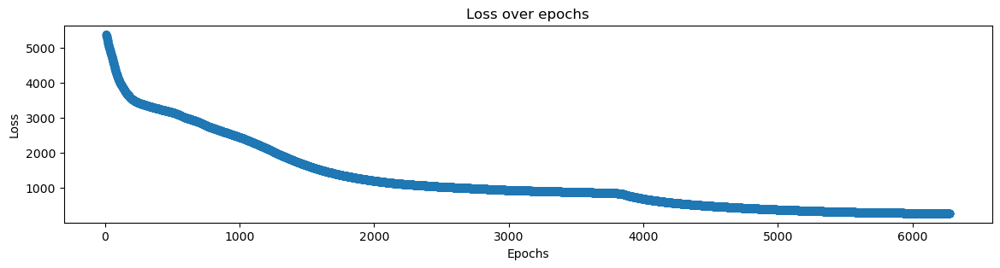

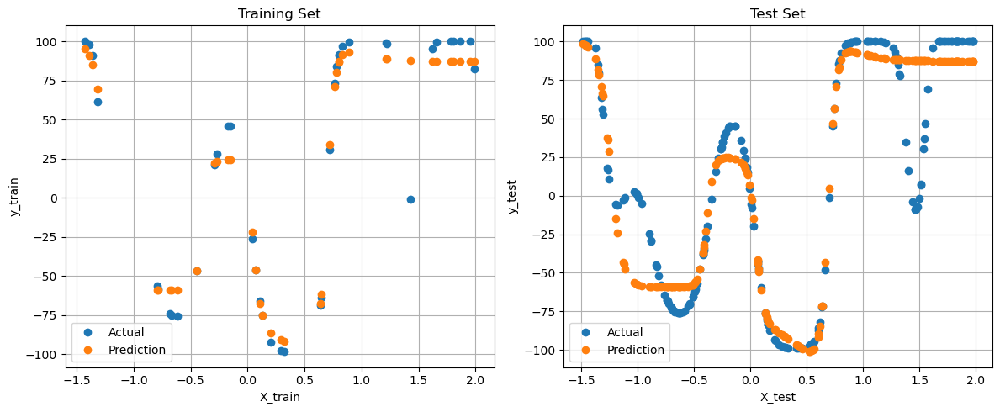

TRAIN MSE = 278.7010568650
TEST MSE  = 616.9156303390
TRAINING TIME = 10.04 SECONDS
Regularization: l1, Early Stopping: False

Epoch 1/10000. Loss = 5680.956420269913.

Epoch 2/10000. Loss = 5619.499346114494.

Epoch 3/10000. Loss = 5590.204100775414.

Epoch 4/10000. Loss = 5572.410104225799.

Epoch 5/10000. Loss = 5550.944363401504.

Epoch 6/10000. Loss = 5520.1982934330745.

Epoch 7/10000. Loss = 5487.885444916339.

Epoch 8/10000. Loss = 5453.070705257657.

Epoch 9/10000. Loss = 5441.165157036934.

Epoch 10/10000. Loss = 5418.384941638551.

Epoch 11/10000. Loss = 5398.225374431277.

Epoch 12/10000. Loss = 5383.150239894816.

Epoch 13/10000. Loss = 5355.835554992887.

Epoch 14/10000. Loss = 5327.0645000068225.

Epoch 15/10000. Loss = 5304.562562451586.

Epoch 16/10000. Loss = 5285.3626365089385.

Epoch 17/10000. Loss = 5267.766498425805.

Epoch 18/10000. Loss = 5244.3947824229.

Epoch 19/10000. Loss = 5221.302776779432.

Epoch 20/10000. Loss = 5205.917263908644.

Epoch 21/10000. Loss 

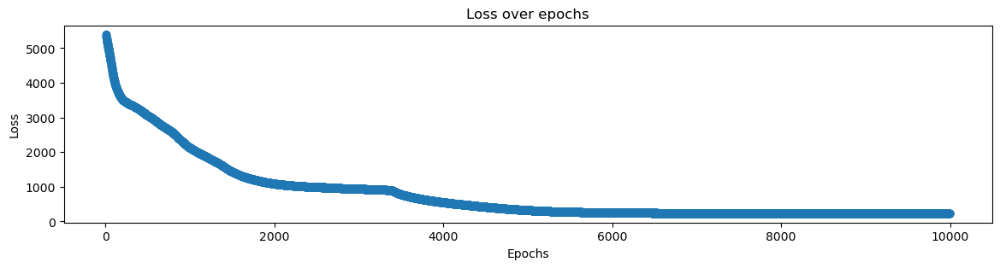

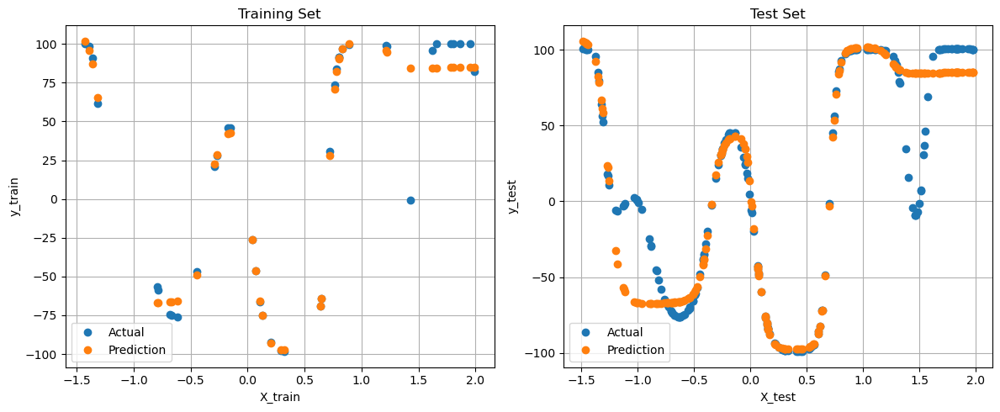

TRAIN MSE = 228.6528498252
TEST MSE  = 618.6544173791
TRAINING TIME = 11.04 SECONDS
Regularization: l2, Early Stopping: True

Epoch 1/10000. Loss = 5597.244847932578.

Epoch 2/10000. Loss = 5552.461069753877.

Epoch 3/10000. Loss = 5508.773160283359.

Epoch 4/10000. Loss = 5483.388694673873.

Epoch 5/10000. Loss = 5462.541481419796.

Epoch 6/10000. Loss = 5426.564891340072.

Epoch 7/10000. Loss = 5398.669286510797.

Epoch 8/10000. Loss = 5368.129312060797.

Epoch 9/10000. Loss = 5348.334735646264.

Epoch 10/10000. Loss = 5336.067089778303.

Epoch 11/10000. Loss = 5313.120128106122.

Epoch 12/10000. Loss = 5296.455884477819.

Epoch 13/10000. Loss = 5282.260510739541.

Epoch 14/10000. Loss = 5270.177500349238.

Epoch 15/10000. Loss = 5251.383154473161.

Epoch 16/10000. Loss = 5236.67835176604.

Epoch 17/10000. Loss = 5213.05837474164.

Epoch 18/10000. Loss = 5194.7442339405.

Epoch 19/10000. Loss = 5177.497536589612.

Epoch 20/10000. Loss = 5162.0406378064745.

Epoch 21/10000. Loss = 514

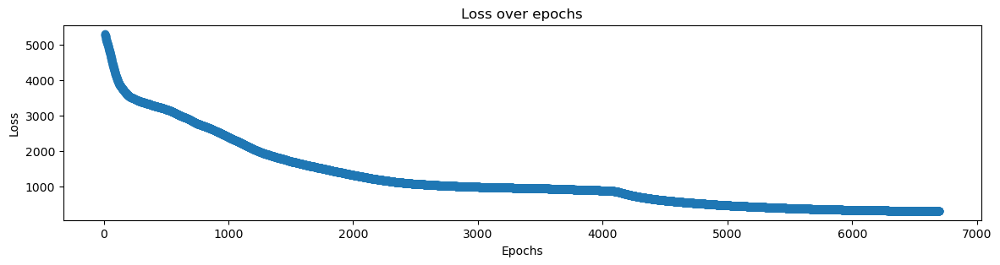

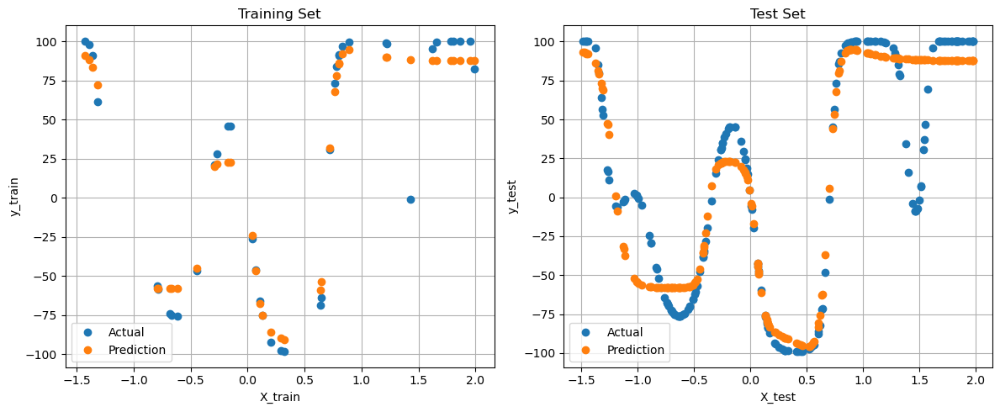

TRAIN MSE = 297.8873342131
TEST MSE  = 617.7028446108
TRAINING TIME = 8.94 SECONDS
Regularization: l2, Early Stopping: False

Epoch 1/10000. Loss = 5672.112492416678.

Epoch 2/10000. Loss = 5613.02592476268.

Epoch 3/10000. Loss = 5564.330792357089.

Epoch 4/10000. Loss = 5524.541844128358.

Epoch 5/10000. Loss = 5491.374750212122.

Epoch 6/10000. Loss = 5470.4321067016135.

Epoch 7/10000. Loss = 5433.625623557048.

Epoch 8/10000. Loss = 5410.674927630324.

Epoch 9/10000. Loss = 5383.614136509648.

Epoch 10/10000. Loss = 5371.766326978594.

Epoch 11/10000. Loss = 5357.201444620638.

Epoch 12/10000. Loss = 5339.616208750506.

Epoch 13/10000. Loss = 5311.035363235789.

Epoch 14/10000. Loss = 5299.415551079098.

Epoch 15/10000. Loss = 5277.0127842426355.

Epoch 16/10000. Loss = 5255.290506614038.

Epoch 17/10000. Loss = 5249.332088800645.

Epoch 18/10000. Loss = 5229.957648020406.

Epoch 19/10000. Loss = 5207.33462392882.

Epoch 20/10000. Loss = 5191.559827222202.

Epoch 21/10000. Loss = 

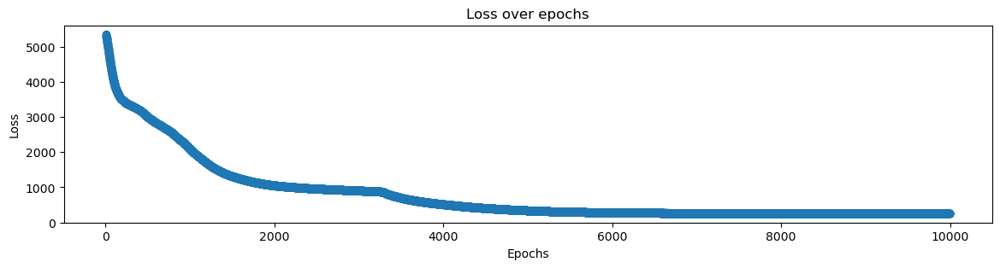

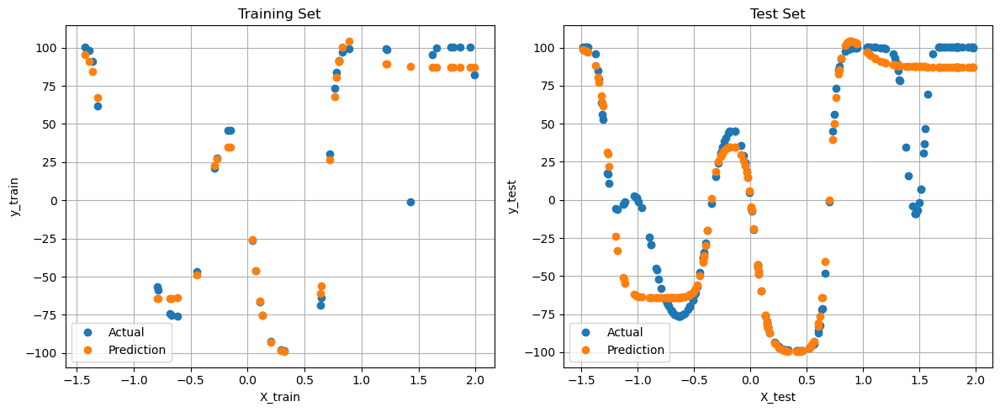

TRAIN MSE = 250.5160596443
TEST MSE  = 620.0885308801
TRAINING TIME = 10.23 SECONDS
Regularization: None, Early Stopping: True

Epoch 1/10000. Loss = 5657.2535907721085.

Epoch 2/10000. Loss = 5604.51052725304.

Epoch 3/10000. Loss = 5567.506314465185.

Epoch 4/10000. Loss = 5533.589194501897.

Epoch 5/10000. Loss = 5494.843426228135.

Epoch 6/10000. Loss = 5484.943056794247.

Epoch 7/10000. Loss = 5464.489021523045.

Epoch 8/10000. Loss = 5433.35671853518.

Epoch 9/10000. Loss = 5400.623154992556.

Epoch 10/10000. Loss = 5376.552234228511.

Epoch 11/10000. Loss = 5358.289233846002.

Epoch 12/10000. Loss = 5333.879256728763.

Epoch 13/10000. Loss = 5308.200517977601.

Epoch 14/10000. Loss = 5281.500315953628.

Epoch 15/10000. Loss = 5269.804665175501.

Epoch 16/10000. Loss = 5252.731052270881.

Epoch 17/10000. Loss = 5234.029647187475.

Epoch 18/10000. Loss = 5214.000276154999.

Epoch 19/10000. Loss = 5191.136685777508.

Epoch 20/10000. Loss = 5172.289390443281.

Epoch 21/10000. Loss =

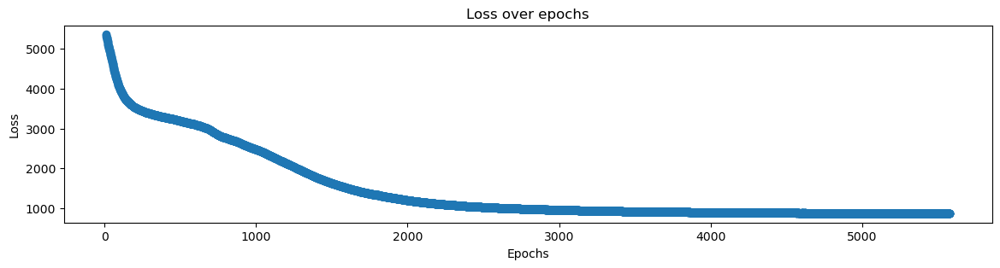

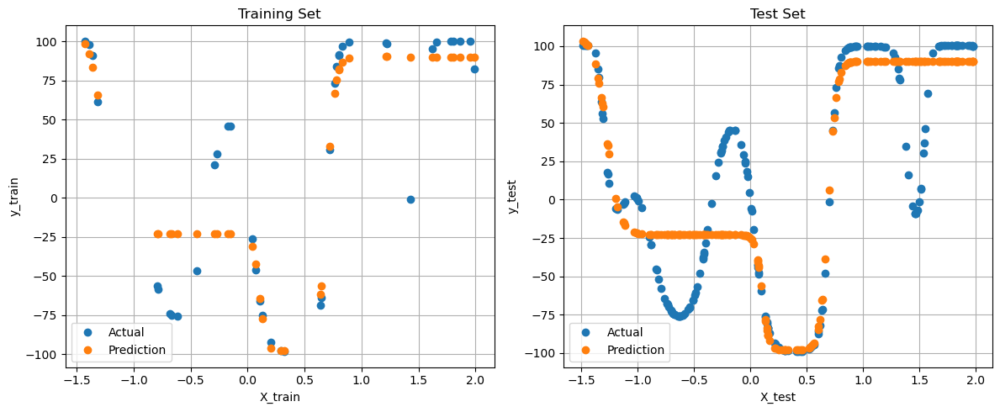

TRAIN MSE = 873.3854438836
TEST MSE  = 1138.6123626814
TRAINING TIME = 7.53 SECONDS
Regularization: None, Early Stopping: False

Epoch 1/10000. Loss = 5739.519397929102.

Epoch 2/10000. Loss = 5673.533936213837.

Epoch 3/10000. Loss = 5649.464508353616.

Epoch 4/10000. Loss = 5604.433785330117.

Epoch 5/10000. Loss = 5573.088176550707.

Epoch 6/10000. Loss = 5539.887993467322.

Epoch 7/10000. Loss = 5502.896600567316.

Epoch 8/10000. Loss = 5471.227928334718.

Epoch 9/10000. Loss = 5453.45740998033.

Epoch 10/10000. Loss = 5429.8995389527745.

Epoch 11/10000. Loss = 5410.513874767949.

Epoch 12/10000. Loss = 5381.097030560848.

Epoch 13/10000. Loss = 5358.224956181984.

Epoch 14/10000. Loss = 5344.717787284077.

Epoch 15/10000. Loss = 5317.126247009382.

Epoch 16/10000. Loss = 5301.913127183267.

Epoch 17/10000. Loss = 5287.542463023805.

Epoch 18/10000. Loss = 5262.961232994337.

Epoch 19/10000. Loss = 5235.06719179069.

Epoch 20/10000. Loss = 5222.269761157568.

Epoch 21/10000. Loss 

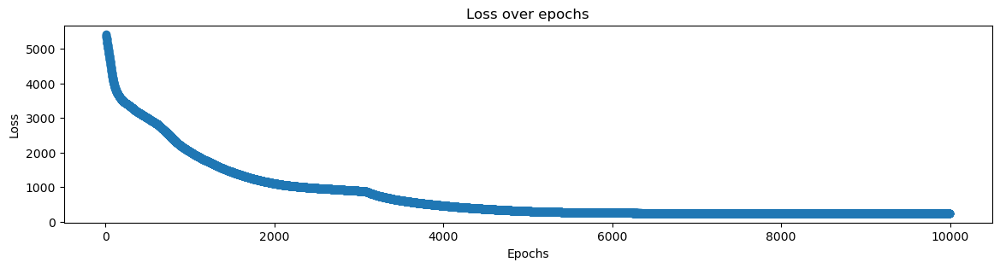

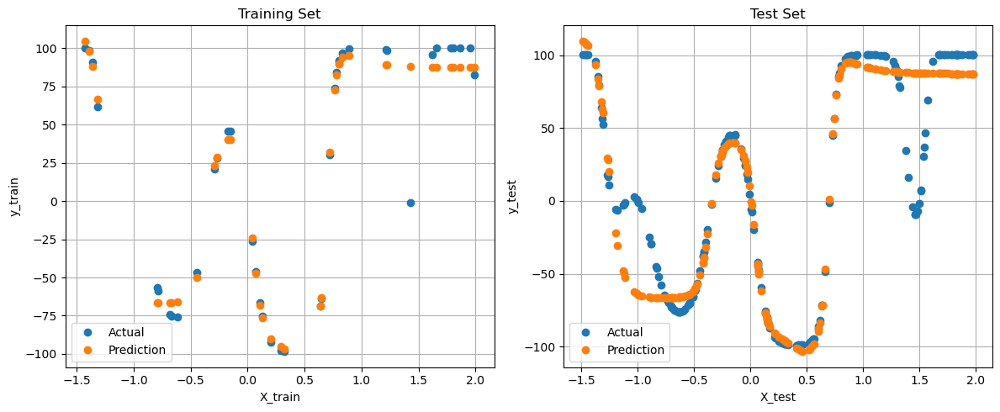

TRAIN MSE = 239.8509769682
TEST MSE  = 619.4515587579
TRAINING TIME = 10.26 SECONDS


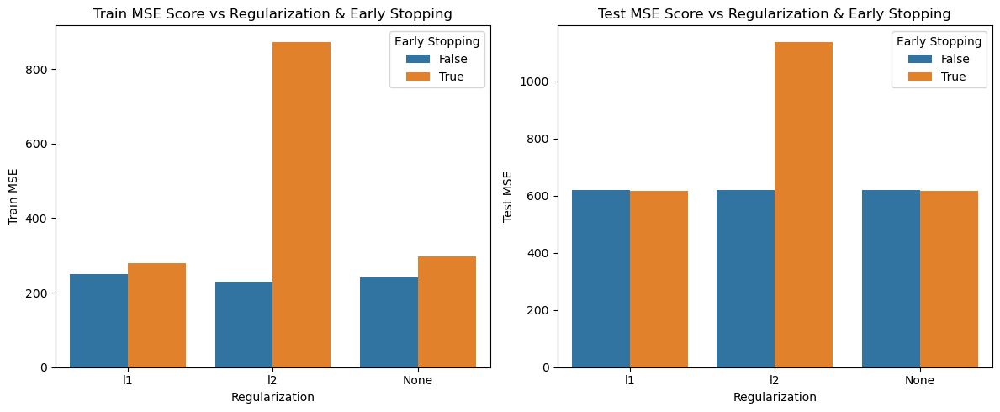

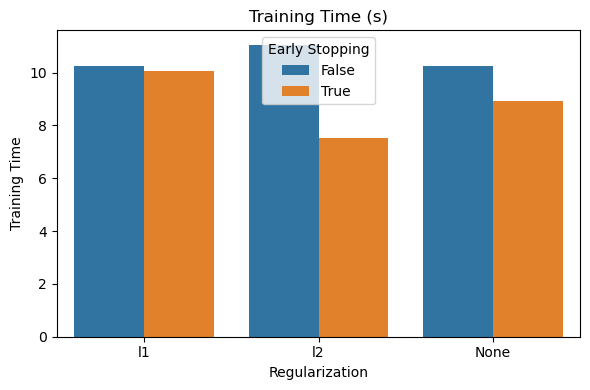

In [37]:
multimodal_sparse_train = pd.read_csv('./data/regression/multimodal-sparse-training.csv')
X_train_multimodal = np.array(multimodal_sparse_train['x']).reshape(-1, 1)
y_train_multimodal = np.array(multimodal_sparse_train['y'])

multimodal_sparse_test = pd.read_csv('./data/regression/multimodal-sparse-test.csv')
X_test_multimodal = np.array(multimodal_sparse_test['x']).reshape(-1, 1)
y_test_multimodal = np.array(multimodal_sparse_test['y'])

regularizations = ['l1', 'l2', 'None']
early_stopping = [True, False]


global_train_mse = []
global_test_mse = []
global_train_time = []

for reg in regularizations:
    for es in early_stopping:
        print(f"Regularization: {reg}, Early Stopping: {es}")
        
        NN = MLP(layers=[
            {'input_dim' : 1, 'output_dim' : 35, 'activation' : 'tanh'},
            {'input_dim' : 35, 'output_dim' : 1, 'activation' : 'linear'}
        ], 
                        weights_init='uniform')
        
        start_time = time.time()
        NN.train(X_train_multimodal, 
                y_train_multimodal, 
                epochs=10000, 
                learning_rate=0.01, 
                batch_size = 30, 
                optimizer='rmsprop', 
                beta=0.9,
                regularization=None if reg == 'None' else reg,
                lambda_reg=0.01,
                X_val=X_test_multimodal,
                y_val=y_test_multimodal,
                early_stopping=es,
                patience=200
                )
        end_time = time.time()
        training_time = end_time - start_time
        global_train_time.append(training_time)

        y_train_pred = NN.predict(X_train_multimodal)
        y_test_pred = NN.predict(X_test_multimodal)

        train_mse = NN.mse(y_train_pred, y_train_multimodal)
        test_mse = NN.mse(y_test_pred, y_test_multimodal)
        create_plots(X_train_multimodal, y_train_multimodal, X_test_multimodal, y_test_multimodal, y_train_pred, y_test_pred)
        print(f"TRAIN MSE = {train_mse:.10f}")
        print(f"TEST MSE  = {test_mse:.10f}")
        print(f"TRAINING TIME = {training_time:.2f} SECONDS")
        global_train_mse.append(train_mse)
        global_test_mse.append(test_mse)
        
results_df = pd.DataFrame({
    'Regularization': regularizations * len(early_stopping),
    'Early Stopping': early_stopping * len(regularizations),
    'Train MSE': global_train_mse,
    'Test MSE': global_test_mse,
    'Training Time': global_train_time
})

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.barplot(data=results_df, x='Regularization', y='Train MSE', hue='Early Stopping')
plt.title('Train MSE Score vs Regularization & Early Stopping')

plt.subplot(1, 2, 2)
sns.barplot(data=results_df, x='Regularization', y='Test MSE', hue='Early Stopping')
plt.title('Test MSE Score vs Regularization & Early Stopping')

plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.barplot(data=results_df, x='Regularization', y='Training Time', hue='Early Stopping')
plt.title('Training Time (s)')
plt.tight_layout()
plt.show()


# xor3-balance dataset

Regularization: l1, Early Stopping: True

Epoch 1/3000. Loss = 0.29524640220116205. F1 Score = 0.4878048780487805.

Epoch 2/3000. Loss = 0.2887030387163733. F1 Score = 0.4878048780487805.

Epoch 3/3000. Loss = 0.2794738953274352. F1 Score = 0.4878048780487805.

Epoch 4/3000. Loss = 0.26828396332779764. F1 Score = 0.4878048780487805.

Epoch 5/3000. Loss = 0.2561022095496155. F1 Score = 0.4878048780487805.

Epoch 6/3000. Loss = 0.2439993721978162. F1 Score = 0.4878048780487805.

Epoch 7/3000. Loss = 0.23286144737815312. F1 Score = 0.4878048780487805.

Epoch 8/3000. Loss = 0.22315438072548813. F1 Score = 0.4878048780487805.

Epoch 9/3000. Loss = 0.2149405908647615. F1 Score = 0.4878048780487805.

Epoch 10/3000. Loss = 0.20810988806962935. F1 Score = 0.4878048780487805.

Epoch 11/3000. Loss = 0.20252611017924185. F1 Score = 0.4878048780487805.

Epoch 12/3000. Loss = 0.19808362782031724. F1 Score = 0.4878048780487805.

Epoch 13/3000. Loss = 0.19462427960759457. F1 Score = 0.4878048780487805

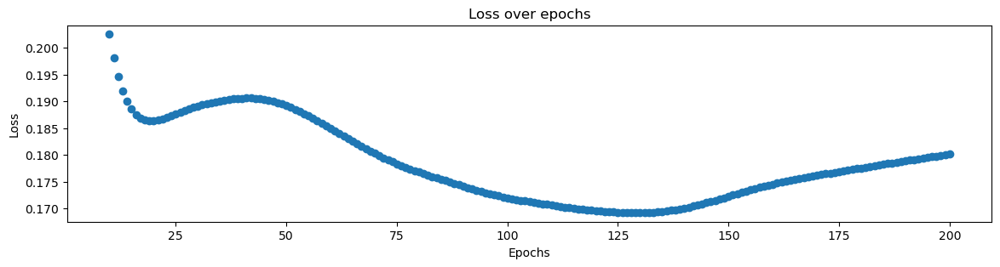

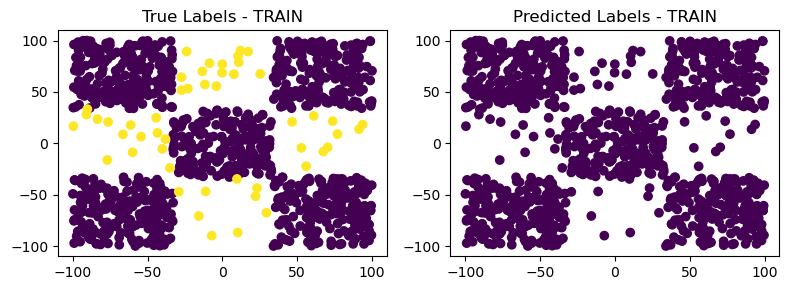

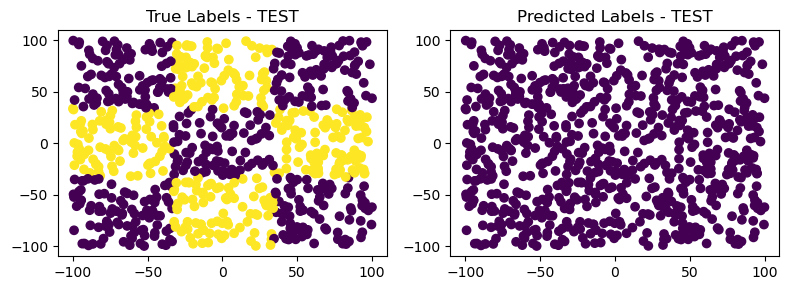

TRAIN F1 = 0.4878048780
TEST F1  = 0.3558776167
TRAINING TIME = 16.65 SECONDS
Regularization: l1, Early Stopping: False

Epoch 1/3000. Loss = 1.4127255329136088. F1 Score = 0.19526872795185723.

Epoch 2/3000. Loss = 1.2963409058986444. F1 Score = 0.20891750556718572.

Epoch 3/3000. Loss = 1.1480128300797945. F1 Score = 0.23593398349587397.

Epoch 4/3000. Loss = 0.9861550418594704. F1 Score = 0.3503195803739199.

Epoch 5/3000. Loss = 0.823520087164545. F1 Score = 0.3803071364046973.

Epoch 6/3000. Loss = 0.6749003560926147. F1 Score = 0.3800651027051296.

Epoch 7/3000. Loss = 0.5519771210248516. F1 Score = 0.4530700873581685.

Epoch 8/3000. Loss = 0.45615411934208216. F1 Score = 0.5443114038992255.

Epoch 9/3000. Loss = 0.3820533094430434. F1 Score = 0.5617840010128908.

Epoch 10/3000. Loss = 0.3254376893242634. F1 Score = 0.5592577582213988.

Epoch 11/3000. Loss = 0.2835837209983424. F1 Score = 0.48705422569614065.

Epoch 12/3000. Loss = 0.2530741099020889. F1 Score = 0.487804878048780

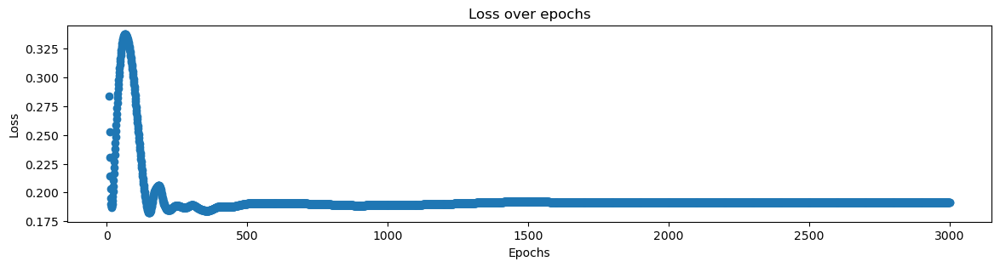

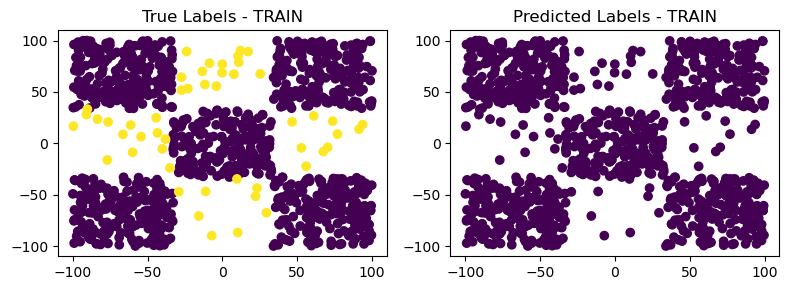

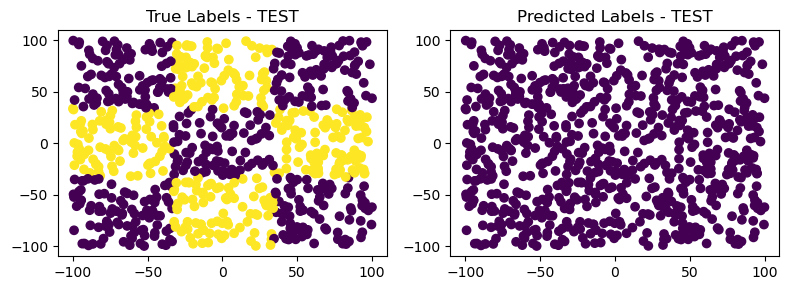

TRAIN F1 = 0.4878048780
TEST F1  = 0.3558776167
TRAINING TIME = 247.96 SECONDS
Regularization: l2, Early Stopping: True

Epoch 1/3000. Loss = 0.5377463781068592. F1 Score = 0.4606649767900786.

Epoch 2/3000. Loss = 0.5166291201245574. F1 Score = 0.46149268140168237.

Epoch 3/3000. Loss = 0.4868430929597786. F1 Score = 0.48034392589637903.

Epoch 4/3000. Loss = 0.4510352783468277. F1 Score = 0.487707091491483.

Epoch 5/3000. Loss = 0.4129980572204198. F1 Score = 0.4878048780487805.

Epoch 6/3000. Loss = 0.37609421086077327. F1 Score = 0.4878048780487805.

Epoch 7/3000. Loss = 0.34180133583070743. F1 Score = 0.4878048780487805.

Epoch 8/3000. Loss = 0.31057646669247707. F1 Score = 0.4878048780487805.

Epoch 9/3000. Loss = 0.2827896601671248. F1 Score = 0.4878048780487805.

Epoch 10/3000. Loss = 0.25873039868075437. F1 Score = 0.4878048780487805.

Epoch 11/3000. Loss = 0.23847179694610904. F1 Score = 0.4878048780487805.

Epoch 12/3000. Loss = 0.22186345330977603. F1 Score = 0.487804878048

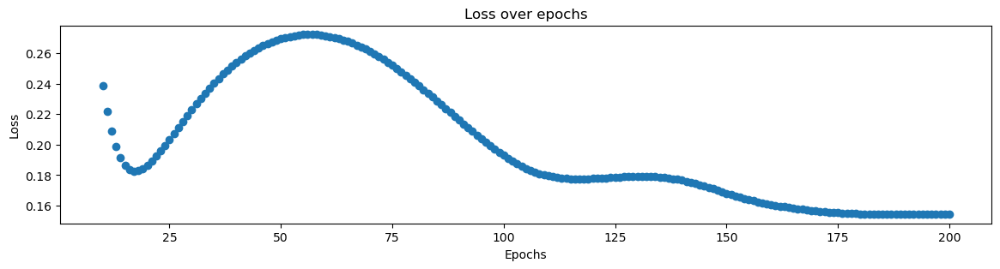

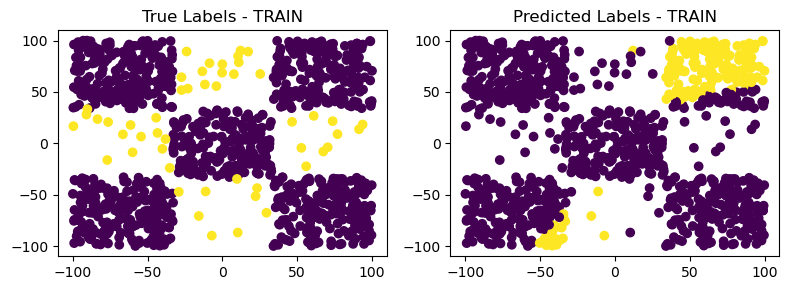

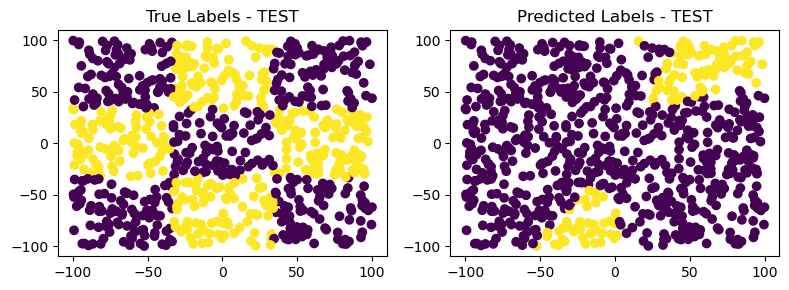

TRAIN F1 = 0.4606649768
TEST F1  = 0.4018959897
TRAINING TIME = 18.12 SECONDS
Regularization: l2, Early Stopping: False

Epoch 1/3000. Loss = 0.5168818412002957. F1 Score = 0.4801980198019802.

Epoch 2/3000. Loss = 0.4985048675410083. F1 Score = 0.486049926578561.

Epoch 3/3000. Loss = 0.4729202077579654. F1 Score = 0.4878048780487805.

Epoch 4/3000. Loss = 0.4423096722818761. F1 Score = 0.4878048780487805.

Epoch 5/3000. Loss = 0.4091704543180273. F1 Score = 0.4878048780487805.

Epoch 6/3000. Loss = 0.3757827879295799. F1 Score = 0.4878048780487805.

Epoch 7/3000. Loss = 0.3438036263306561. F1 Score = 0.4878048780487805.

Epoch 8/3000. Loss = 0.3143138679988437. F1 Score = 0.4878048780487805.

Epoch 9/3000. Loss = 0.28802393373569046. F1 Score = 0.4878048780487805.

Epoch 10/3000. Loss = 0.26528081558474914. F1 Score = 0.4878048780487805.

Epoch 11/3000. Loss = 0.24609200918868043. F1 Score = 0.4878048780487805.

Epoch 12/3000. Loss = 0.2302210428581878. F1 Score = 0.4878048780487805.

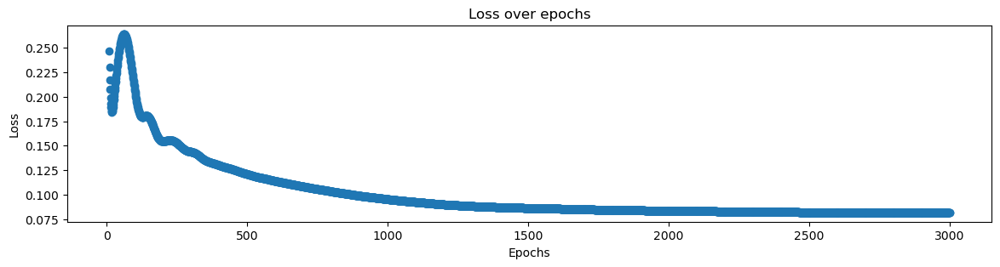

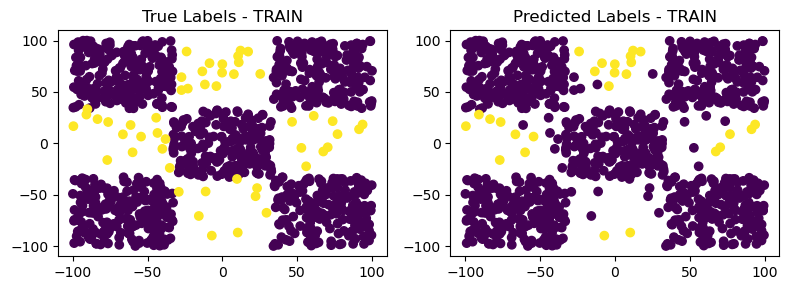

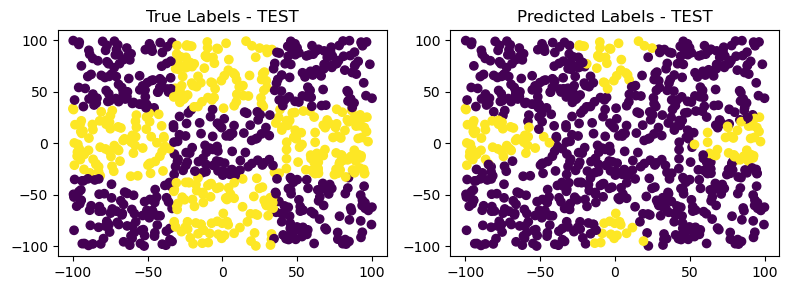

TRAIN F1 = 0.8361764094
TEST F1  = 0.6675859533
TRAINING TIME = 261.83 SECONDS
Regularization: None, Early Stopping: True

Epoch 1/3000. Loss = 0.8243915602202259. F1 Score = 0.44669340193704593.

Epoch 2/3000. Loss = 0.7782999757048765. F1 Score = 0.4564717250264575.

Epoch 3/3000. Loss = 0.7119671684051158. F1 Score = 0.45602155190803867.

Epoch 4/3000. Loss = 0.6326617661757779. F1 Score = 0.4581882863908683.

Epoch 5/3000. Loss = 0.5504008567737342. F1 Score = 0.45780983516832563.

Epoch 6/3000. Loss = 0.47533113173762115. F1 Score = 0.4965274387664109.

Epoch 7/3000. Loss = 0.4119797851127054. F1 Score = 0.582922419460881.

Epoch 8/3000. Loss = 0.3586954980220216. F1 Score = 0.5076507909166595.

Epoch 9/3000. Loss = 0.3137491388241613. F1 Score = 0.4878048780487805.

Epoch 10/3000. Loss = 0.2768133135089383. F1 Score = 0.4878048780487805.

Epoch 11/3000. Loss = 0.24811625161846315. F1 Score = 0.4878048780487805.

Epoch 12/3000. Loss = 0.22717920951307105. F1 Score = 0.487804878048

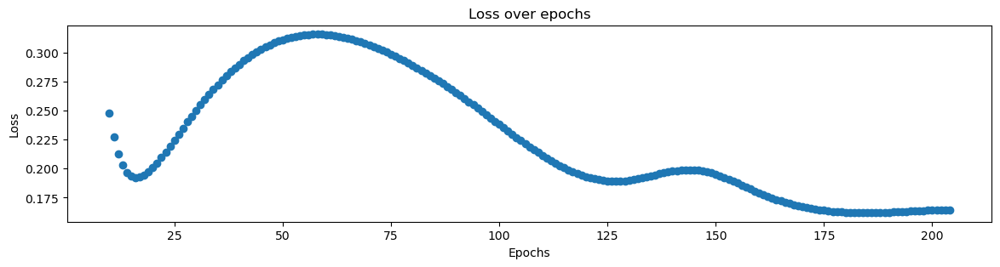

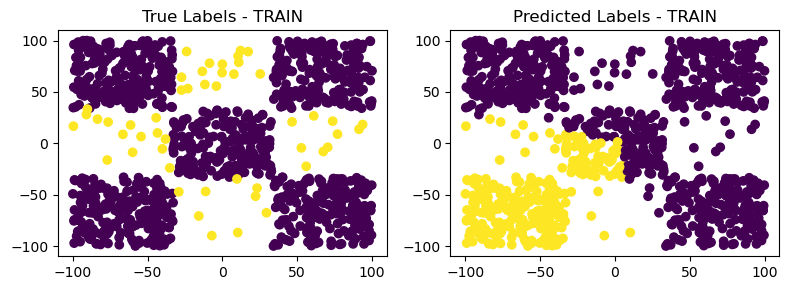

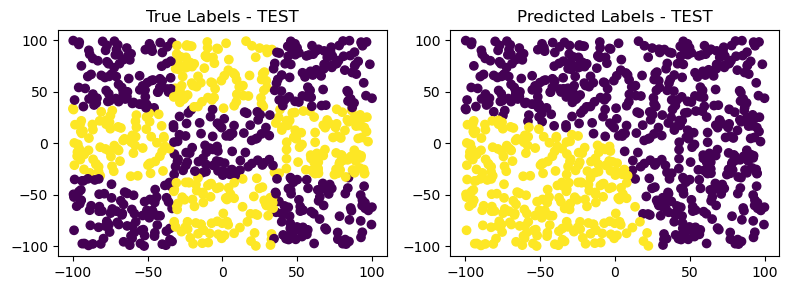

TRAIN F1 = 0.4578098352
TEST F1  = 0.5381516883
TRAINING TIME = 17.29 SECONDS
Regularization: None, Early Stopping: False

Epoch 1/3000. Loss = 0.3805174778816234. F1 Score = 0.4925710760372217.

Epoch 2/3000. Loss = 0.36420852073325033. F1 Score = 0.5043778296336185.

Epoch 3/3000. Loss = 0.3408284293667286. F1 Score = 0.5413338476899338.

Epoch 4/3000. Loss = 0.3118169773413676. F1 Score = 0.613502511692361.

Epoch 5/3000. Loss = 0.2797216231016473. F1 Score = 0.6099159039481239.

Epoch 6/3000. Loss = 0.2485007934565415. F1 Score = 0.4878048780487805.

Epoch 7/3000. Loss = 0.2224489124948216. F1 Score = 0.4878048780487805.

Epoch 8/3000. Loss = 0.20350246402416794. F1 Score = 0.4878048780487805.

Epoch 9/3000. Loss = 0.19080118953833158. F1 Score = 0.4878048780487805.

Epoch 10/3000. Loss = 0.1830364302876449. F1 Score = 0.4878048780487805.

Epoch 11/3000. Loss = 0.17892502207339356. F1 Score = 0.4878048780487805.

Epoch 12/3000. Loss = 0.17700617858257908. F1 Score = 0.4878048780487

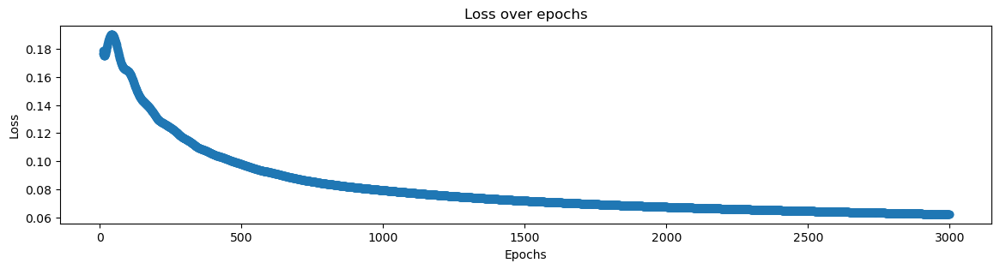

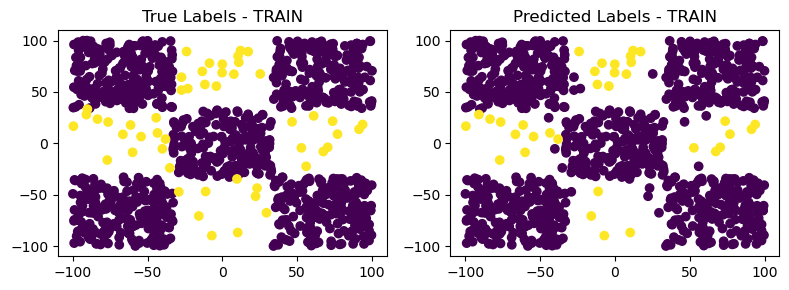

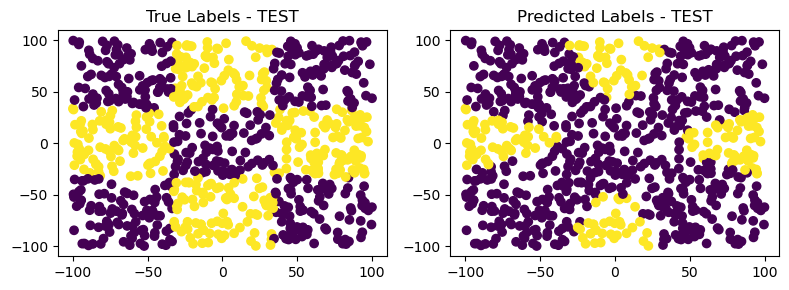

TRAIN F1 = 0.9007936508
TEST F1  = 0.7747806097
TRAINING TIME = 262.54 SECONDS


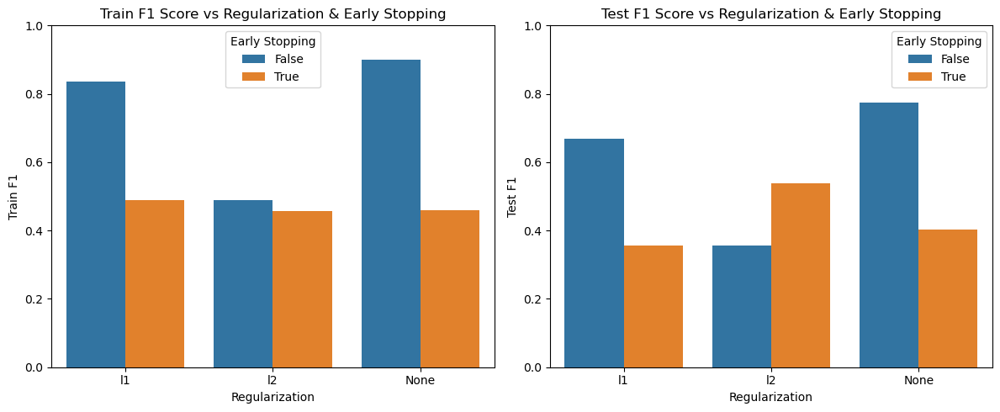

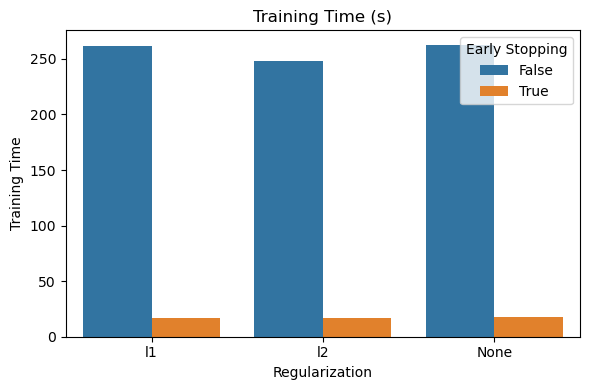

In [38]:
xor3_balance_train = pd.read_csv('./data/classification/xor3-balance-training.csv')

X_train_xor3 = xor3_balance_train.iloc[:, 0:(len(xor3_balance_train.iloc[1]) - 1)]
y_train_xor3 = np.array(xor3_balance_train.iloc[:,-1])

xor3_balance_test = pd.read_csv('./data/classification/xor3-balance-test.csv')

X_test_xor3 = xor3_balance_test.iloc[:, 0:(len(xor3_balance_test.iloc[1]) - 1)]
y_test_xor3 = np.array(xor3_balance_test['c'])

regularizations = ['l1', 'l2','None']
early_stopping = [True, False]


global_train_mse = []
global_test_mse = []
global_train_time = []

for reg in regularizations:
    for es in early_stopping:
        print(f"Regularization: {reg}, Early Stopping: {es}")
        
        NN = MLP(layers=[
            {'input_dim' : 2, 'output_dim' : 131, 'activation' : 'relu'},
            {'input_dim' : 131, 'output_dim' : 57, 'activation' : 'sigmoid'},
            {'input_dim' : 57, 'output_dim' : 2, 'activation' : 'softmax'}
        ], 
                        weights_init='xavier',
                        classification=True)
        
        start_time = time.time()
        NN.train(X_train_xor3, 
                 y_train_xor3, 
                 epochs=3000, 
                 learning_rate=0.001, 
                 batch_size = None, 
                 optimizer='momentum', 
                 beta = 0.99,
                 regularization=None if reg == 'None' else reg,
                 lambda_reg=0.01,
                 X_val=X_test_xor3,
                 y_val=y_test_xor3,
                 early_stopping=es,
                 patience=200
                )
        
        end_time = time.time()
        training_time = end_time - start_time
        global_train_time.append(training_time)

        y_train_pred = NN.predict(X_train_xor3)
        y_test_pred = NN.predict(X_test_xor3)

        train_mse = NN.f1_score(y_train_pred, y_train_xor3)
        test_mse = NN.f1_score(y_test_pred, y_test_xor3)
        create_plots(X_train_xor3, y_train_xor3, X_test_xor3, y_test_xor3, y_train_pred, y_test_pred, classification=True)
        print(f"TRAIN F1 = {train_mse:.10f}")
        print(f"TEST F1  = {test_mse:.10f}")
        print(f"TRAINING TIME = {training_time:.2f} SECONDS")
        global_train_mse.append(train_mse)
        global_test_mse.append(test_mse)
        
results_df = pd.DataFrame({
    'Regularization': regularizations * len(early_stopping),
    'Early Stopping': early_stopping * len(regularizations),
    'Train F1': global_train_mse,
    'Test F1': global_test_mse,
    'Training Time': global_train_time
})

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.barplot(data=results_df, x='Regularization', y='Train F1', hue='Early Stopping')
plt.title('Train F1 Score vs Regularization & Early Stopping')
plt.ylim(0, 1)

plt.subplot(1, 2, 2)
sns.barplot(data=results_df, x='Regularization', y='Test F1', hue='Early Stopping')
plt.title('Test F1 Score vs Regularization & Early Stopping')
plt.ylim(0, 1)

plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.barplot(data=results_df, x='Regularization', y='Training Time', hue='Early Stopping')
plt.title('Training Time (s)')
plt.tight_layout()
plt.show()


# rings5-sparse dataset

Regularization: l1, Early Stopping: True

Epoch 1/10000. Loss = 3.1694707533769666. F1 Score = 0.12869335747330862.

Epoch 2/10000. Loss = 3.0845315383236227. F1 Score = 0.12869844680804973.

Epoch 3/10000. Loss = 2.9950215246996934. F1 Score = 0.1291420018077023.

Epoch 4/10000. Loss = 2.9141521807596704. F1 Score = 0.12274365424917351.

Epoch 5/10000. Loss = 2.83429300071227. F1 Score = 0.1390264349833083.

Epoch 6/10000. Loss = 2.7660224263068756. F1 Score = 0.1552680079123848.

Epoch 7/10000. Loss = 2.7037618443780325. F1 Score = 0.14934871543118966.

Epoch 8/10000. Loss = 2.645694806767587. F1 Score = 0.1568495549898368.

Epoch 9/10000. Loss = 2.588064192911659. F1 Score = 0.15488287250384025.

Epoch 10/10000. Loss = 2.5221817220773484. F1 Score = 0.15376619191347546.

Epoch 11/10000. Loss = 2.455484503587012. F1 Score = 0.15432390817469205.

Epoch 12/10000. Loss = 2.3969032616751518. F1 Score = 0.15754760118601077.

Epoch 13/10000. Loss = 2.3337043450567325. F1 Score = 0.16175588

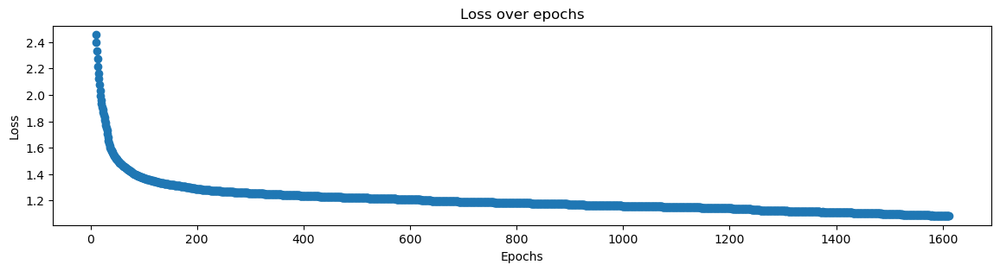

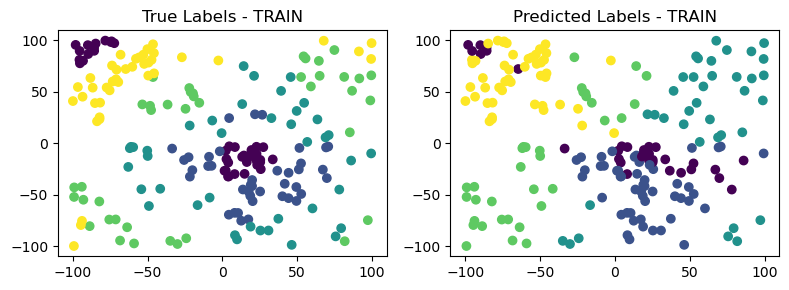

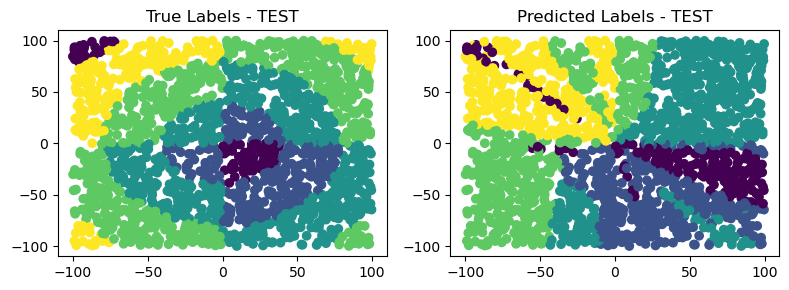

TRAIN F1 = 0.5521032452
TEST F1  = 0.4103544950
TRAINING TIME = 70.32 SECONDS
Regularization: l1, Early Stopping: False

Epoch 1/10000. Loss = 2.6750558589729714. F1 Score = 0.22368561089825462.

Epoch 2/10000. Loss = 2.6326404057141666. F1 Score = 0.22368561089825462.

Epoch 3/10000. Loss = 2.5841752818009884. F1 Score = 0.2311944352067398.

Epoch 4/10000. Loss = 2.5356686704613907. F1 Score = 0.23491926456168416.

Epoch 5/10000. Loss = 2.487049628506144. F1 Score = 0.24676162706618593.

Epoch 6/10000. Loss = 2.4377121876808907. F1 Score = 0.24657202689019736.

Epoch 7/10000. Loss = 2.389891948039465. F1 Score = 0.2538119545283295.

Epoch 8/10000. Loss = 2.3489172627650845. F1 Score = 0.2741995568420177.

Epoch 9/10000. Loss = 2.310626582351033. F1 Score = 0.2774100734494795.

Epoch 10/10000. Loss = 2.272915205118726. F1 Score = 0.2813730813330453.

Epoch 11/10000. Loss = 2.2373033922962873. F1 Score = 0.2813730813330453.

Epoch 12/10000. Loss = 2.2028006188662683. F1 Score = 0.281033

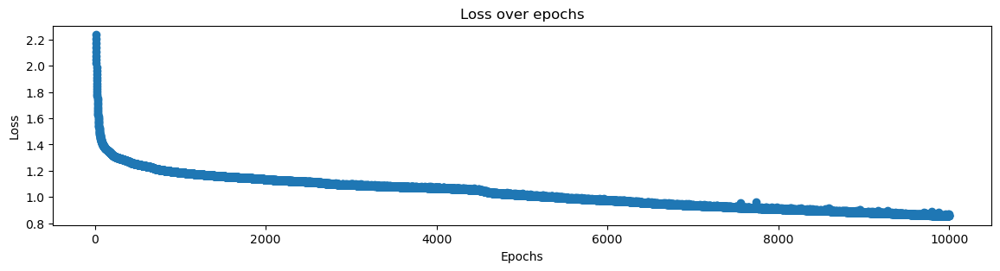

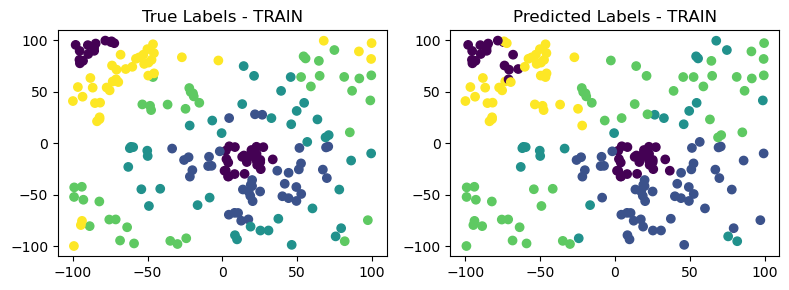

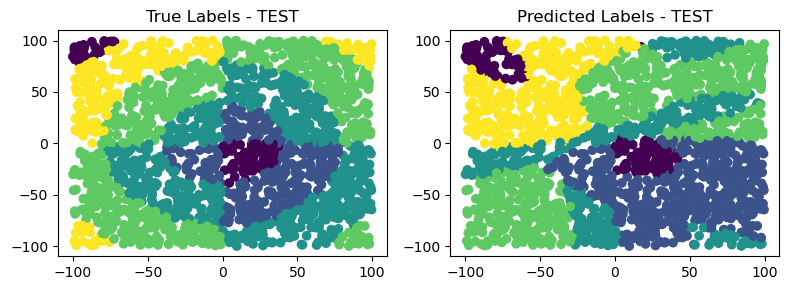

TRAIN F1 = 0.6852114401
TEST F1  = 0.5374653193
TRAINING TIME = 402.32 SECONDS
Regularization: l2, Early Stopping: True

Epoch 1/10000. Loss = 2.8466373077236518. F1 Score = 0.08314744079449962.

Epoch 2/10000. Loss = 2.7825035773717737. F1 Score = 0.08314744079449962.

Epoch 3/10000. Loss = 2.704348964618881. F1 Score = 0.0937046004842615.

Epoch 4/10000. Loss = 2.6298389585724795. F1 Score = 0.09505747126436781.

Epoch 5/10000. Loss = 2.558523270551976. F1 Score = 0.10109734513274335.

Epoch 6/10000. Loss = 2.4837781436378825. F1 Score = 0.10109734513274335.

Epoch 7/10000. Loss = 2.407690626338747. F1 Score = 0.10109734513274335.

Epoch 8/10000. Loss = 2.327223349092305. F1 Score = 0.1070308689289945.

Epoch 9/10000. Loss = 2.2477352835159286. F1 Score = 0.11664335664335664.

Epoch 10/10000. Loss = 2.1775437550647445. F1 Score = 0.12821054582522473.

Epoch 11/10000. Loss = 2.1083525145293875. F1 Score = 0.1281394093607834.

Epoch 12/10000. Loss = 2.038063876172808. F1 Score = 0.1388

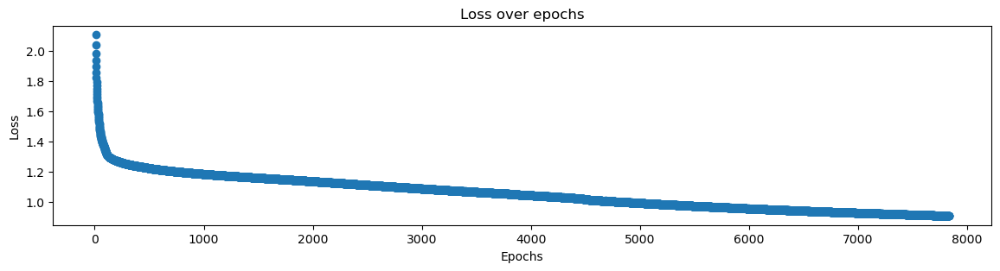

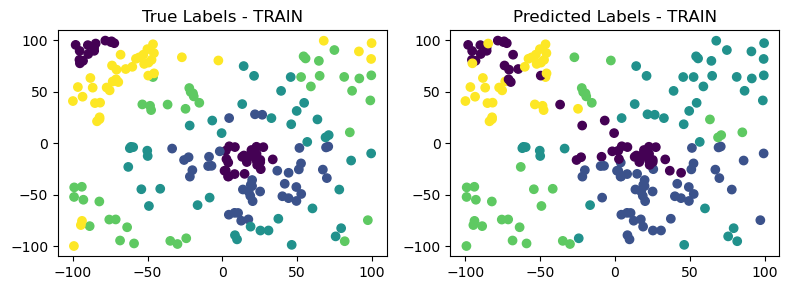

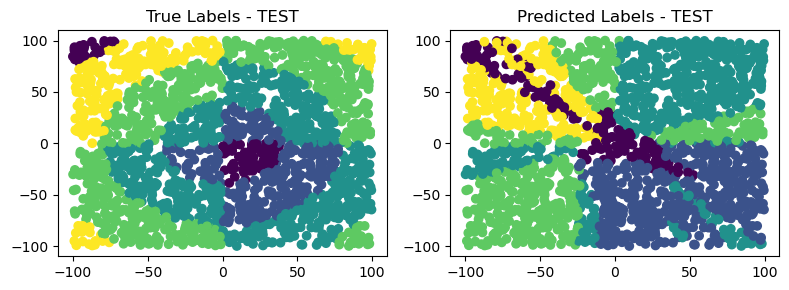

TRAIN F1 = 0.6125769919
TEST F1  = 0.4405267518
TRAINING TIME = 341.98 SECONDS
Regularization: l2, Early Stopping: False

Epoch 1/10000. Loss = 2.596452046271297. F1 Score = 0.07927958560618117.

Epoch 2/10000. Loss = 2.5304393491375903. F1 Score = 0.08341645996777462.

Epoch 3/10000. Loss = 2.4586614971946226. F1 Score = 0.0952874907445211.

Epoch 4/10000. Loss = 2.383692930921713. F1 Score = 0.09512424334558721.

Epoch 5/10000. Loss = 2.3160454692942745. F1 Score = 0.0950302112685929.

Epoch 6/10000. Loss = 2.251952154020941. F1 Score = 0.12241198144147566.

Epoch 7/10000. Loss = 2.201076909391377. F1 Score = 0.13857411064784336.

Epoch 8/10000. Loss = 2.1593637352856527. F1 Score = 0.13845966968346413.

Epoch 9/10000. Loss = 2.1174182211396997. F1 Score = 0.1289887525861891.

Epoch 10/10000. Loss = 2.0794825035743383. F1 Score = 0.12813934446345024.

Epoch 11/10000. Loss = 2.0467725575793105. F1 Score = 0.13411541721923498.

Epoch 12/10000. Loss = 2.017614603754927. F1 Score = 0.145

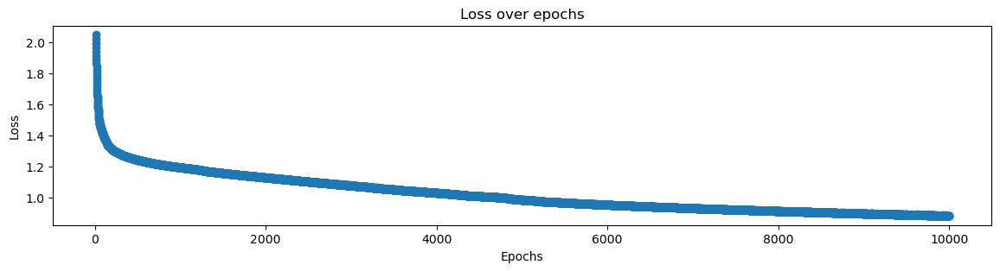

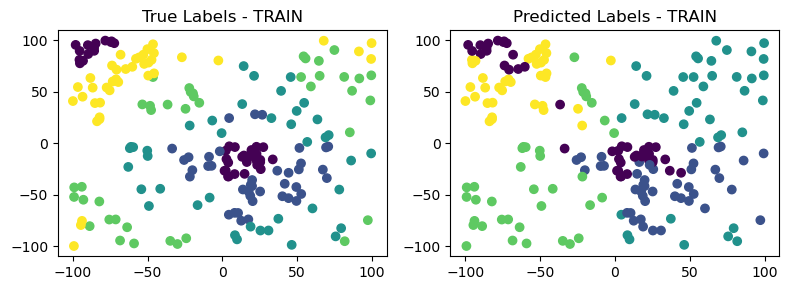

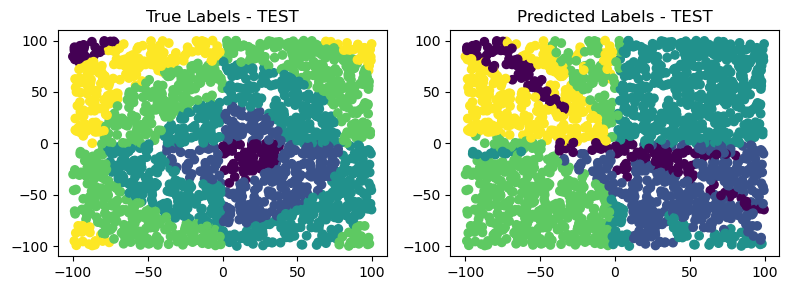

TRAIN F1 = 0.6430674573
TEST F1  = 0.4578985827
TRAINING TIME = 415.23 SECONDS
Regularization: None, Early Stopping: True

Epoch 1/10000. Loss = 1.895819535390758. F1 Score = 0.2292589699850097.

Epoch 2/10000. Loss = 1.8618467640634517. F1 Score = 0.24313701366049317.

Epoch 3/10000. Loss = 1.8257105765384245. F1 Score = 0.2640975867591104.

Epoch 4/10000. Loss = 1.791700312335297. F1 Score = 0.2604592312104729.

Epoch 5/10000. Loss = 1.7597637640703896. F1 Score = 0.26578646622813046.

Epoch 6/10000. Loss = 1.7309762829130084. F1 Score = 0.2953231142033668.

Epoch 7/10000. Loss = 1.7041893563727404. F1 Score = 0.29528392047436347.

Epoch 8/10000. Loss = 1.6786945078177427. F1 Score = 0.2999477110984647.

Epoch 9/10000. Loss = 1.6561466862132914. F1 Score = 0.2999477110984647.

Epoch 10/10000. Loss = 1.6364235648303842. F1 Score = 0.30452024640418285.

Epoch 11/10000. Loss = 1.6161381890614128. F1 Score = 0.3091731772128689.

Epoch 12/10000. Loss = 1.5997447762134076. F1 Score = 0.316

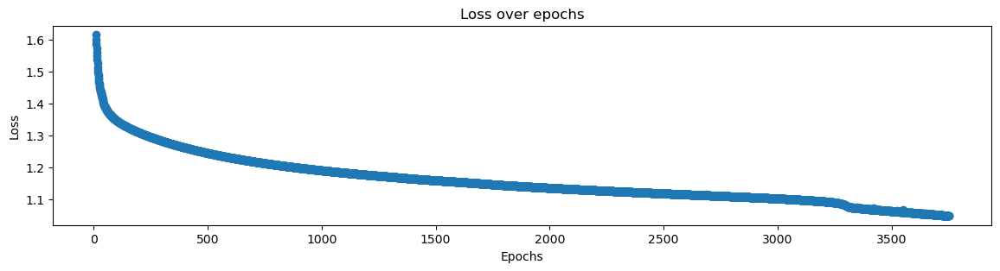

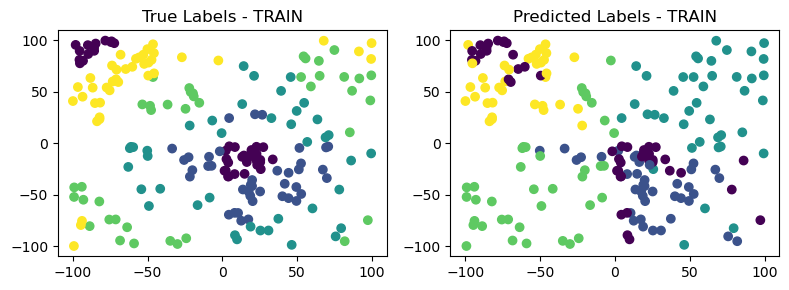

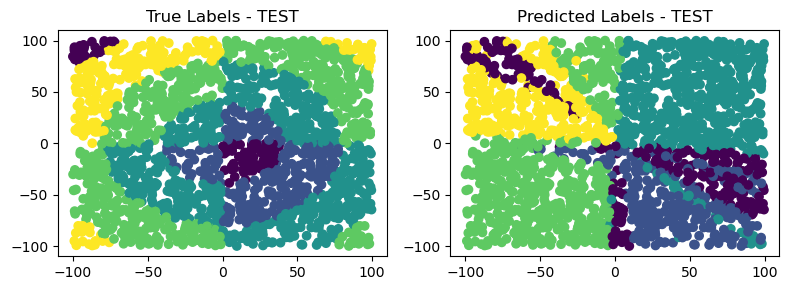

TRAIN F1 = 0.5849369778
TEST F1  = 0.3700652195
TRAINING TIME = 170.87 SECONDS
Regularization: None, Early Stopping: False

Epoch 1/10000. Loss = 2.2296805203476056. F1 Score = 0.25519688644688643.

Epoch 2/10000. Loss = 2.198365461885501. F1 Score = 0.25913703158634627.

Epoch 3/10000. Loss = 2.1642460169406714. F1 Score = 0.2593748858373584.

Epoch 4/10000. Loss = 2.1282512460518155. F1 Score = 0.27099600594532064.

Epoch 5/10000. Loss = 2.0917277207712526. F1 Score = 0.2862832983393472.

Epoch 6/10000. Loss = 2.060776083818751. F1 Score = 0.2852474401013234.

Epoch 7/10000. Loss = 2.02990876431369. F1 Score = 0.28654325232548017.

Epoch 8/10000. Loss = 2.0013658897066664. F1 Score = 0.2945347253814073.

Epoch 9/10000. Loss = 1.9752528443055197. F1 Score = 0.2958940063346043.

Epoch 10/10000. Loss = 1.9500445817251963. F1 Score = 0.2959790294334725.

Epoch 11/10000. Loss = 1.9231159547163292. F1 Score = 0.3068876334517691.

Epoch 12/10000. Loss = 1.8995037532426804. F1 Score = 0.3078

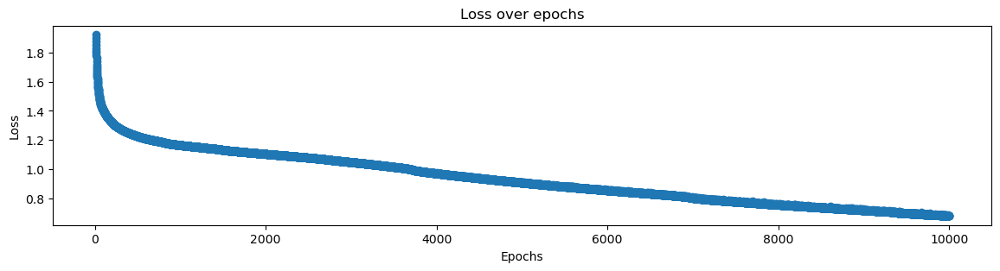

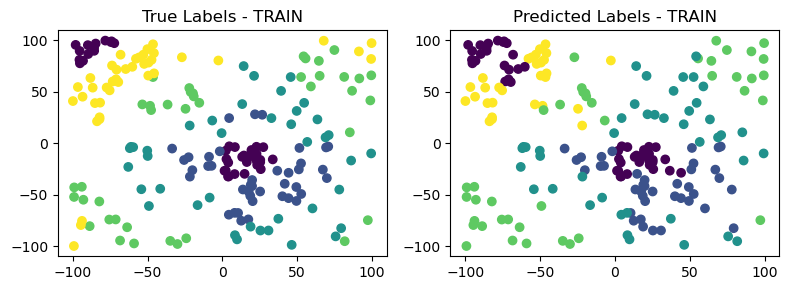

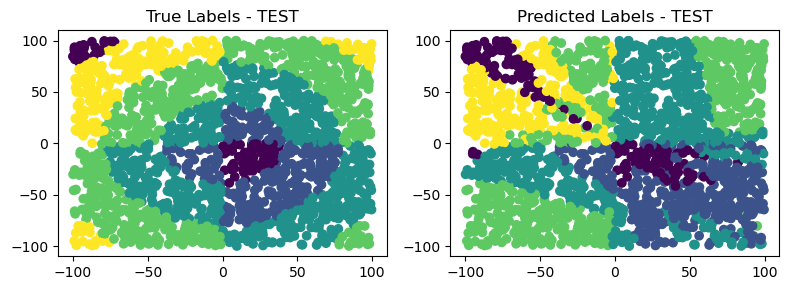

TRAIN F1 = 0.7807425821
TEST F1  = 0.5537444632
TRAINING TIME = 407.25 SECONDS


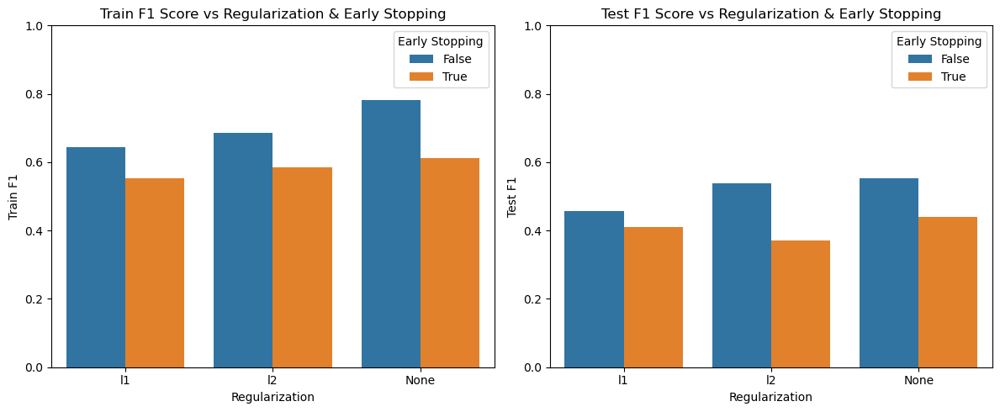

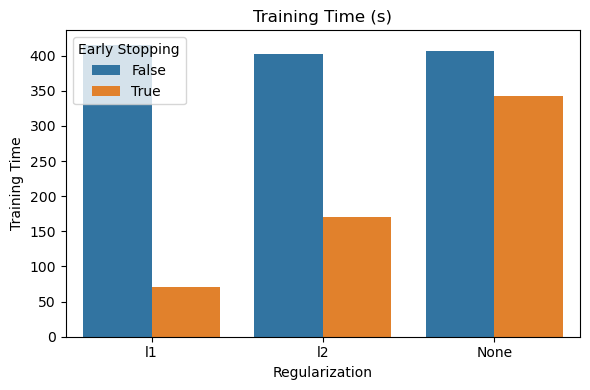

In [39]:
rings5_sparse_train = pd.read_csv('./data/classification/rings5-sparse-training.csv')

X_train_rings5 = rings5_sparse_train.iloc[:, 0:(len(rings5_sparse_train.iloc[1]) - 1)]
y_train_rings5 = np.array(rings5_sparse_train.iloc[:,-1])

rings5_sparse_test = pd.read_csv('./data/classification/rings5-sparse-test.csv')

X_test_rings5 = rings5_sparse_test.iloc[:, 0:(len(rings5_sparse_test.iloc[1]) - 1)]
y_test_rings5 = np.array(rings5_sparse_test['c'])

regularizations = ['l1', 'l2', 'None']
early_stopping = [True, False]


global_train_mse = []
global_test_mse = []
global_train_time = []

for reg in regularizations:
    for es in early_stopping:
        print(f"Regularization: {reg}, Early Stopping: {es}")

        NN = MLP(layers=[
            {'input_dim' : 2, 'output_dim' : 30, 'activation' : 'tanh'},
            {'input_dim' : 30, 'output_dim' : 5, 'activation' : 'softmax'}  
        ],
                weights_init='uniform',
                classification=True)
        
        start_time = time.time()        
        NN.train(X_train_rings5,
                 y_train_rings5, 
                 epochs=10000, 
                 learning_rate=0.0001, 
                 batch_size=20, 
                 optimizer='momentum',
                 regularization=None if reg == 'None' else reg,
                 lambda_reg=0.01,
                 X_val=X_test_rings5,
                 y_val=y_test_rings5,
                 early_stopping=es,
                 patience=200
                )
        
        end_time = time.time()
        training_time = end_time - start_time
        global_train_time.append(training_time)

        y_train_pred = NN.predict(X_train_rings5)
        y_test_pred = NN.predict(X_test_rings5)

        train_mse = NN.f1_score(y_train_pred, y_train_rings5)
        test_mse = NN.f1_score(y_test_pred, y_test_rings5)
        create_plots(X_train_rings5, y_train_rings5, X_test_rings5, y_test_rings5, y_train_pred, y_test_pred, classification=True)
        print(f"TRAIN F1 = {train_mse:.10f}")
        print(f"TEST F1  = {test_mse:.10f}")
        print(f"TRAINING TIME = {training_time:.2f} SECONDS")
        global_train_mse.append(train_mse)
        global_test_mse.append(test_mse)
        
results_df = pd.DataFrame({
    'Regularization': regularizations * len(early_stopping),
    'Early Stopping': early_stopping * len(regularizations),
    'Train F1': global_train_mse,
    'Test F1': global_test_mse,
    'Training Time': global_train_time
})

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.barplot(data=results_df, x='Regularization', y='Train F1', hue='Early Stopping')
plt.title('Train F1 Score vs Regularization & Early Stopping')
plt.ylim(0, 1)

plt.subplot(1, 2, 2)
sns.barplot(data=results_df, x='Regularization', y='Test F1', hue='Early Stopping')
plt.title('Test F1 Score vs Regularization & Early Stopping')
plt.ylim(0, 1)

plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.barplot(data=results_df, x='Regularization', y='Training Time', hue='Early Stopping')
plt.title('Training Time (s)')
plt.tight_layout()
plt.show()

# rings3-balance dataset

Regularization: l1, Early Stopping: True

Epoch 1/20000. Loss = 1.0305319544182163. F1 Score = 0.2353637954809544.

Epoch 2/20000. Loss = 1.001067664457028. F1 Score = 0.3054802235411342.

Epoch 3/20000. Loss = 0.9758605619531128. F1 Score = 0.35391466373426894.

Epoch 4/20000. Loss = 0.9543272849344587. F1 Score = 0.3517162384196216.

Epoch 5/20000. Loss = 0.935732367663392. F1 Score = 0.35024867672026366.

Epoch 6/20000. Loss = 0.9194966897675948. F1 Score = 0.35772142093342424.

Epoch 7/20000. Loss = 0.9050705418010667. F1 Score = 0.3689005683140581.

Epoch 8/20000. Loss = 0.8922611270895617. F1 Score = 0.3860159716060337.

Epoch 9/20000. Loss = 0.8807743973928517. F1 Score = 0.3862030092541977.

Epoch 10/20000. Loss = 0.8703281990606498. F1 Score = 0.3888634386954715.

Epoch 11/20000. Loss = 0.8607850902438559. F1 Score = 0.39415986510670437.

Epoch 12/20000. Loss = 0.8519924734202221. F1 Score = 0.39690338316513296.

Epoch 13/20000. Loss = 0.8438504297013119. F1 Score = 0.40570244

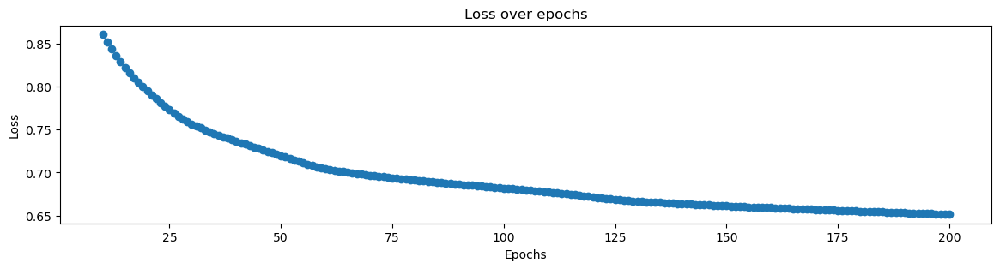

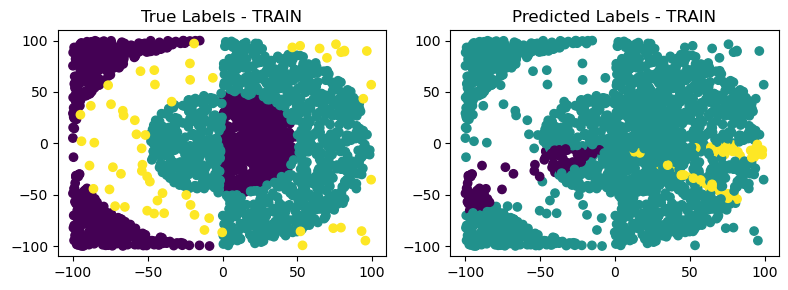

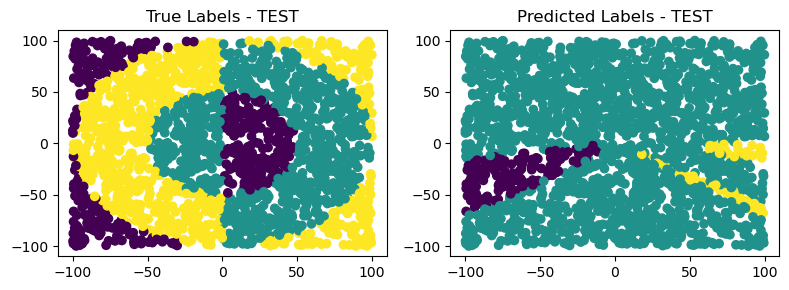

TRAIN F1 = 0.2353637955
TEST F1  = 0.2255792988
TRAINING TIME = 462.83 SECONDS
Regularization: l1, Early Stopping: False

Epoch 1/20000. Loss = 1.0770018799939107. F1 Score = 0.38262553864062027.

Epoch 2/20000. Loss = 1.0141293981176183. F1 Score = 0.3980842843948243.

Epoch 3/20000. Loss = 0.9664821127181995. F1 Score = 0.42156784387248364.

Epoch 4/20000. Loss = 0.9297486425086416. F1 Score = 0.45998484698679043.

Epoch 5/20000. Loss = 0.9012697060669829. F1 Score = 0.4547508616976475.

Epoch 6/20000. Loss = 0.8776352406039625. F1 Score = 0.4615161554462417.

Epoch 7/20000. Loss = 0.857546535252259. F1 Score = 0.471932582899284.

Epoch 8/20000. Loss = 0.8405965824186518. F1 Score = 0.4563491345543231.

Epoch 9/20000. Loss = 0.8260319241364535. F1 Score = 0.44995394846199904.

Epoch 10/20000. Loss = 0.8133162238611547. F1 Score = 0.45078129637324155.

Epoch 11/20000. Loss = 0.8020942496124387. F1 Score = 0.4301813350736528.

Epoch 12/20000. Loss = 0.792111868491784. F1 Score = 0.4305

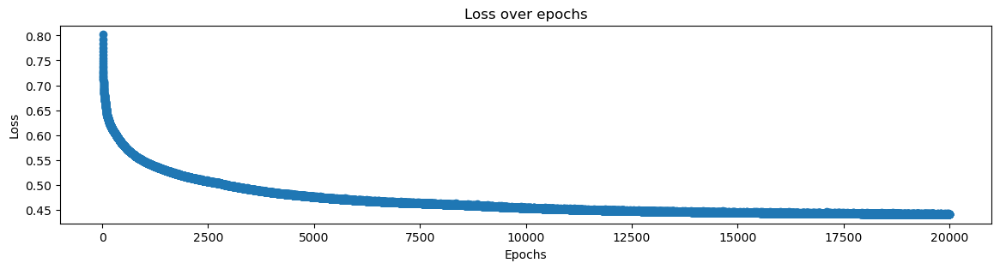

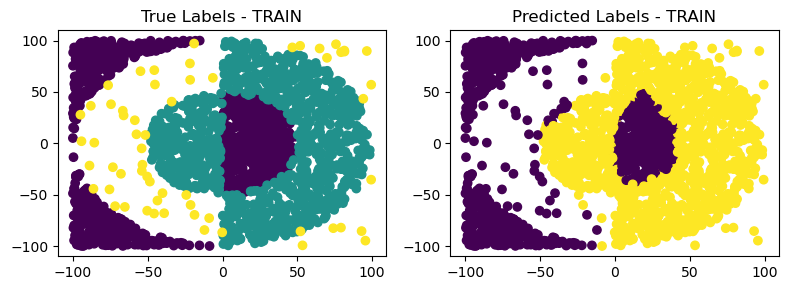

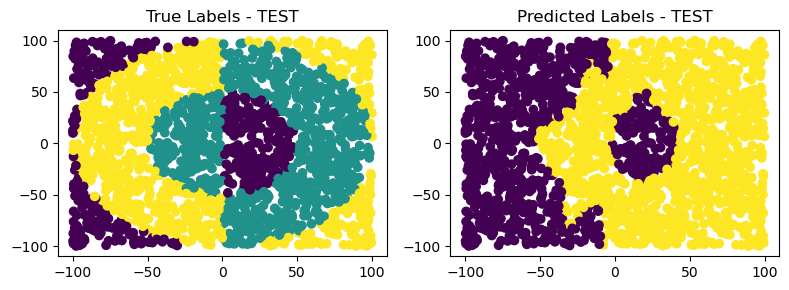

TRAIN F1 = 0.6028752437
TEST F1  = 0.4590915635
TRAINING TIME = 5591.52 SECONDS
Regularization: l2, Early Stopping: True

Epoch 1/20000. Loss = 1.5068059609646178. F1 Score = 0.2179242064335052.

Epoch 2/20000. Loss = 1.397990491247728. F1 Score = 0.226553616375021.

Epoch 3/20000. Loss = 1.3086473562378875. F1 Score = 0.23215656645854077.

Epoch 4/20000. Loss = 1.233864415297166. F1 Score = 0.2388346667617701.

Epoch 5/20000. Loss = 1.1702778550231265. F1 Score = 0.2425698936689019.

Epoch 6/20000. Loss = 1.1162533516850128. F1 Score = 0.2471145559519761.

Epoch 7/20000. Loss = 1.0701619526334056. F1 Score = 0.32023118746163565.

Epoch 8/20000. Loss = 1.0309874004179875. F1 Score = 0.4060321449346784.

Epoch 9/20000. Loss = 0.9974265304708838. F1 Score = 0.4345582632359449.

Epoch 10/20000. Loss = 0.9689211283668889. F1 Score = 0.44604963308998596.

Epoch 11/20000. Loss = 0.9445435156654168. F1 Score = 0.4595911741425463.

Epoch 12/20000. Loss = 0.9236337419083481. F1 Score = 0.461814

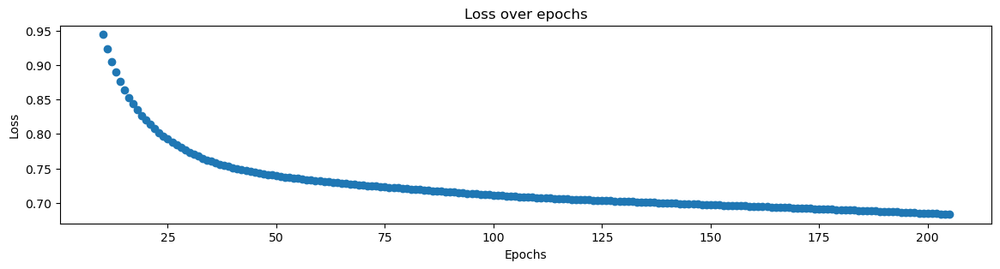

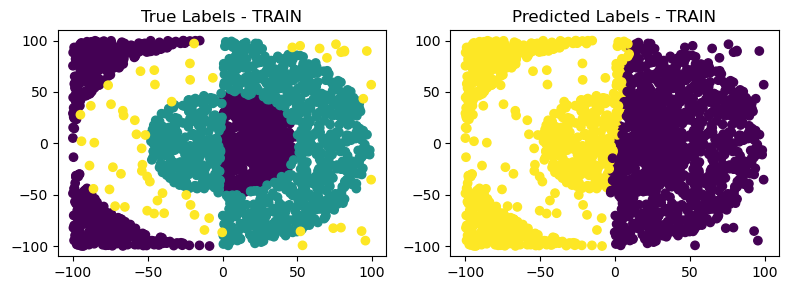

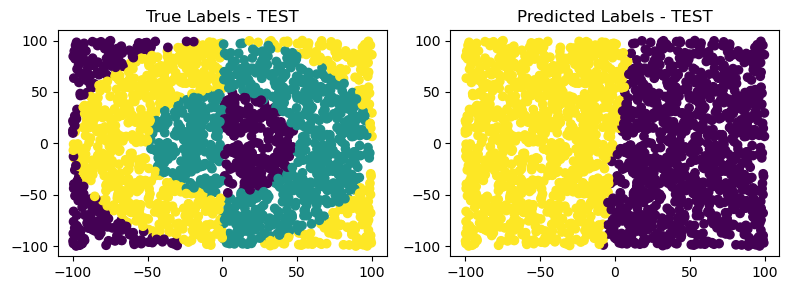

TRAIN F1 = 0.2471145560
TEST F1  = 0.4215194059
TRAINING TIME = 5644.49 SECONDS
Regularization: l2, Early Stopping: False

Epoch 1/20000. Loss = 1.292455250508958. F1 Score = 0.18879165808840426.

Epoch 2/20000. Loss = 1.2048522131166517. F1 Score = 0.193777579198005.

Epoch 3/20000. Loss = 1.135592341720627. F1 Score = 0.21115245095356913.

Epoch 4/20000. Loss = 1.0789877302971023. F1 Score = 0.23235145969081017.

Epoch 5/20000. Loss = 1.0306204260356164. F1 Score = 0.28331244461969446.

Epoch 6/20000. Loss = 0.9889656203670545. F1 Score = 0.28749654040786204.

Epoch 7/20000. Loss = 0.9532702920434307. F1 Score = 0.29904427843648507.

Epoch 8/20000. Loss = 0.9229429855700721. F1 Score = 0.3566486626424701.

Epoch 9/20000. Loss = 0.8972233326833564. F1 Score = 0.3820441313818978.

Epoch 10/20000. Loss = 0.8754533798665091. F1 Score = 0.43081766734713617.

Epoch 11/20000. Loss = 0.8568463086526514. F1 Score = 0.4522079369905457.

Epoch 12/20000. Loss = 0.840800412397937. F1 Score = 0.46

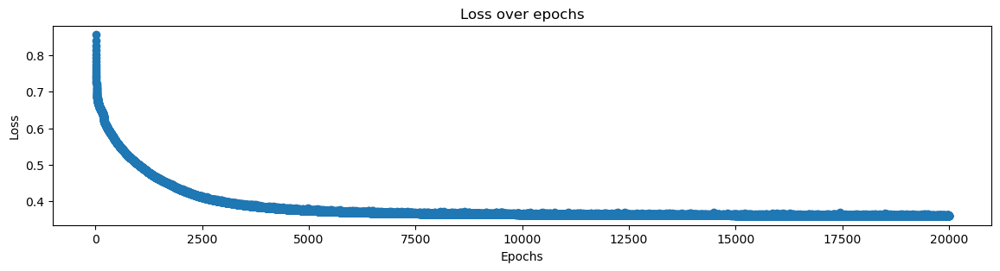

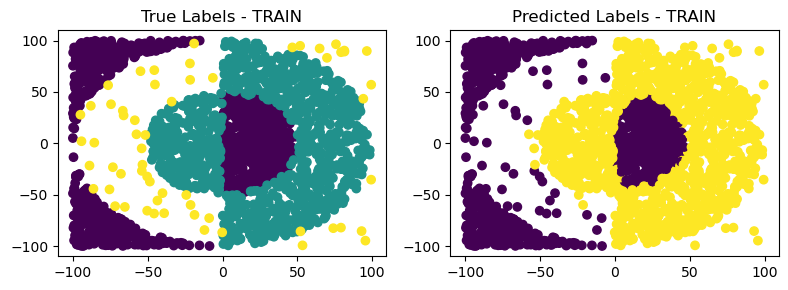

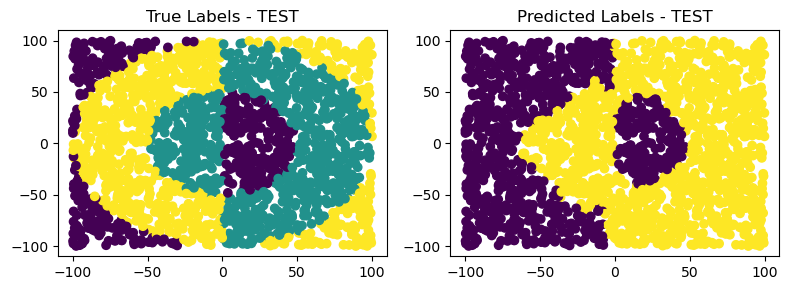

TRAIN F1 = 0.6274624677
TEST F1  = 0.4804042108
TRAINING TIME = 10473.65 SECONDS
Regularization: None, Early Stopping: True

Epoch 1/20000. Loss = 1.4132117298708937. F1 Score = 0.13816483753844255.

Epoch 2/20000. Loss = 1.305964501320673. F1 Score = 0.15008008837337752.

Epoch 3/20000. Loss = 1.2196149662278128. F1 Score = 0.1737001757710025.

Epoch 4/20000. Loss = 1.1499473594377954. F1 Score = 0.2632274917295987.

Epoch 5/20000. Loss = 1.092967368505136. F1 Score = 0.2915426921492212.

Epoch 6/20000. Loss = 1.0461150965818506. F1 Score = 0.3485889938469737.

Epoch 7/20000. Loss = 1.0073585353043293. F1 Score = 0.39321791571939024.

Epoch 8/20000. Loss = 0.9750377357665282. F1 Score = 0.4033274345662605.

Epoch 9/20000. Loss = 0.9478571637152466. F1 Score = 0.40189737098083805.

Epoch 10/20000. Loss = 0.9248118393756043. F1 Score = 0.4099524211976085.

Epoch 11/20000. Loss = 0.9050672526720765. F1 Score = 0.41027104076653464.

Epoch 12/20000. Loss = 0.8880562546895943. F1 Score = 0.

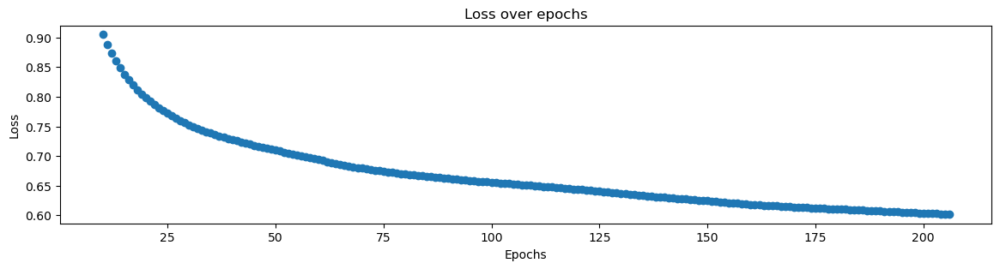

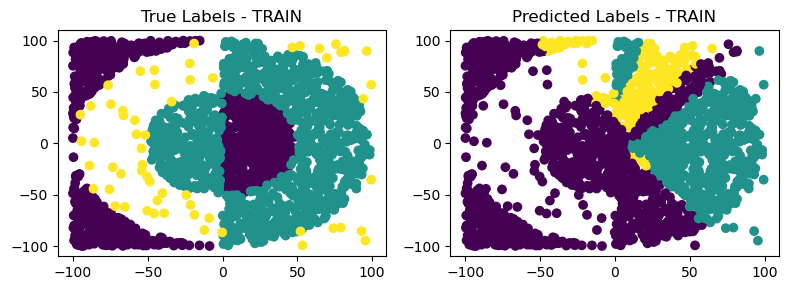

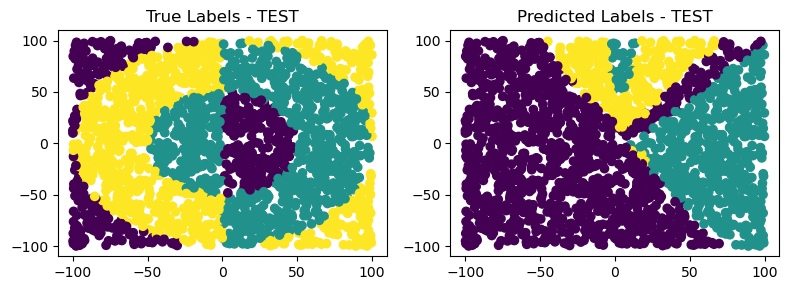

TRAIN F1 = 0.3932179157
TEST F1  = 0.3628848783
TRAINING TIME = 10526.03 SECONDS
Regularization: None, Early Stopping: False

Epoch 1/20000. Loss = 1.583050890750818. F1 Score = 0.14826668774037194.

Epoch 2/20000. Loss = 1.4453783609275133. F1 Score = 0.15043934107610835.

Epoch 3/20000. Loss = 1.3318476359240383. F1 Score = 0.1540792833074996.

Epoch 4/20000. Loss = 1.2339127023014549. F1 Score = 0.19383476894132787.

Epoch 5/20000. Loss = 1.1547113974653684. F1 Score = 0.25121133706851195.

Epoch 6/20000. Loss = 1.0915501444279732. F1 Score = 0.34286439559467263.

Epoch 7/20000. Loss = 1.0415575791835536. F1 Score = 0.3882777656229135.

Epoch 8/20000. Loss = 1.0029461358699003. F1 Score = 0.41156031815012817.

Epoch 9/20000. Loss = 0.9722046333911915. F1 Score = 0.43137000548097615.

Epoch 10/20000. Loss = 0.946646239925937. F1 Score = 0.44751046772337744.

Epoch 11/20000. Loss = 0.9247275060942877. F1 Score = 0.45047030352143413.

Epoch 12/20000. Loss = 0.9056625841180127. F1 Score

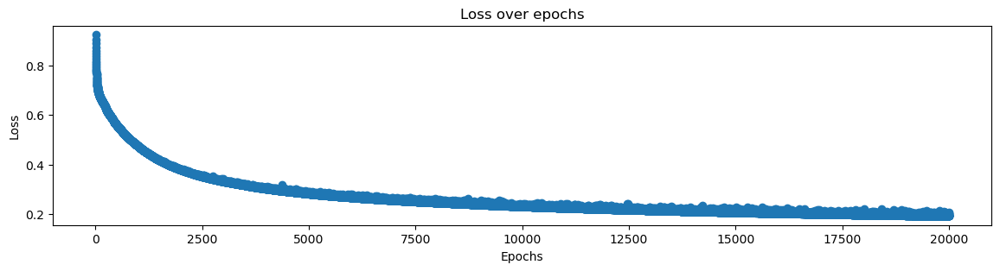

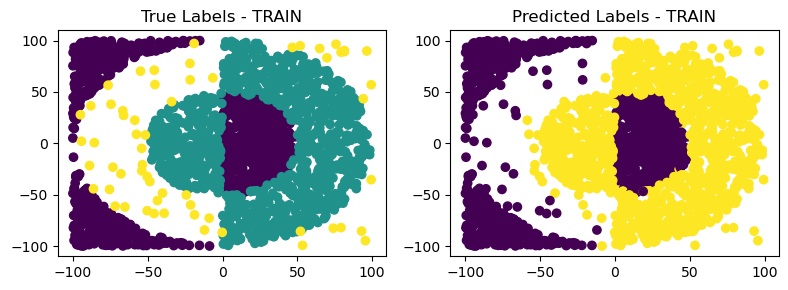

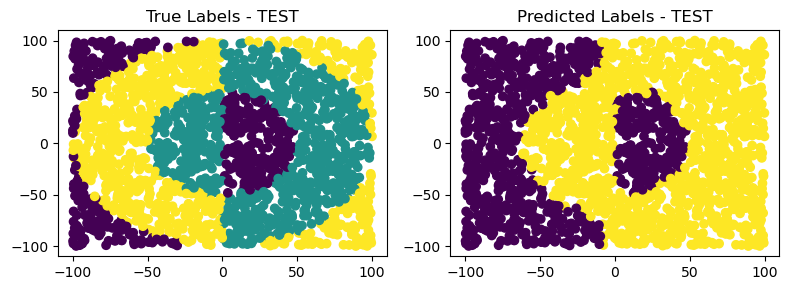

TRAIN F1 = 0.6499256240
TEST F1  = 0.4921442297
TRAINING TIME = 15294.82 SECONDS


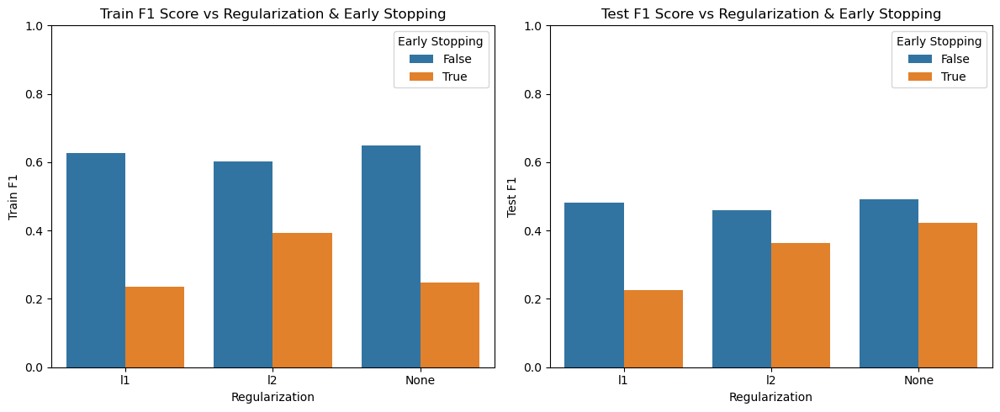

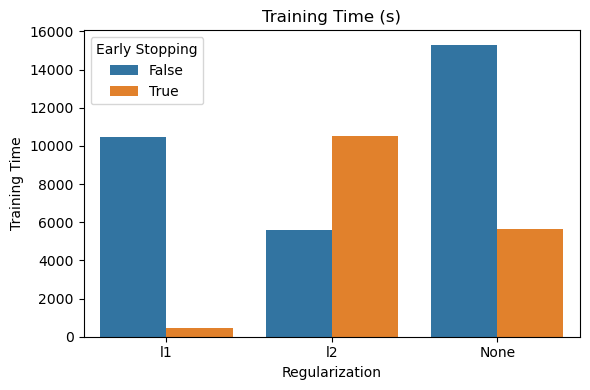

In [40]:
rings3_balance_train = pd.read_csv('./data/classification/rings3-balance-training.csv')

X_train_rings3 = rings3_balance_train.iloc[:, 0:(len(rings3_balance_train.iloc[1]) - 1)]
y_train_rings3 = np.array(rings3_balance_train.iloc[:,-1])

rings3_balance_test = pd.read_csv('./data/classification/rings3-balance-test.csv')

X_test_rings3 = rings3_balance_test.iloc[:, 0:(len(rings3_balance_test.iloc[1]) - 1)]
y_test_rings3 = np.array(rings3_balance_test['c'])

regularizations = ['l1', 'l2', 'None']
early_stopping = [True, False]


global_train_mse = []
global_test_mse = []
global_train_time = []

for reg in regularizations:
    for es in early_stopping:
        print(f"Regularization: {reg}, Early Stopping: {es}")

        NN = MLP(layers=[
            {'input_dim' : 2, 'output_dim' : 35, 'activation' : 'sigmoid'},
            {'input_dim' : 35, 'output_dim' : 3, 'activation' : 'softmax'}
        ], 
                        weights_init='xavier',
                        classification=True)

        NN.train(X_train_rings3, 
                 y_train_rings3, 
                 epochs=20000, 
                 learning_rate=0.0004, 
                 batch_size = 30,
                 lambda_reg=0.01,
                 regularization=None if reg == 'None' else reg,                 
                 X_val=X_test_rings3,
                 y_val=y_test_rings3,
                 early_stopping=es,
                 patience=200
                )
        
        end_time = time.time()
        training_time = end_time - start_time
        global_train_time.append(training_time)

        y_train_pred = NN.predict(X_train_rings3)
        y_test_pred = NN.predict(X_test_rings3)

        train_mse = NN.f1_score(y_train_pred, y_train_rings3)
        test_mse = NN.f1_score(y_test_pred, y_test_rings3)
        create_plots(X_train_rings3, y_train_rings3, X_test_rings3, y_test_rings3, y_train_pred, y_test_pred, classification=True)
        print(f"TRAIN F1 = {train_mse:.10f}")
        print(f"TEST F1  = {test_mse:.10f}")
        print(f"TRAINING TIME = {training_time:.2f} SECONDS")
        global_train_mse.append(train_mse)
        global_test_mse.append(test_mse)
        
results_df = pd.DataFrame({
    'Regularization': regularizations * len(early_stopping),
    'Early Stopping': early_stopping * len(regularizations),
    'Train F1': global_train_mse,
    'Test F1': global_test_mse,
    'Training Time': global_train_time
})

plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.barplot(data=results_df, x='Regularization', y='Train F1', hue='Early Stopping')
plt.title('Train F1 Score vs Regularization & Early Stopping')
plt.ylim(0, 1)

plt.subplot(1, 2, 2)
sns.barplot(data=results_df, x='Regularization', y='Test F1', hue='Early Stopping')
plt.title('Test F1 Score vs Regularization & Early Stopping')
plt.ylim(0, 1)

plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
sns.barplot(data=results_df, x='Regularization', y='Training Time', hue='Early Stopping')
plt.title('Training Time (s)')
plt.tight_layout()
plt.show()